# Afriat

In [1]:
scan=0.2

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: 2e2u6wya
Name: holographic-speeder-151
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/2e2u6wya
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155931-2e2u6wya/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2533,3270,9440
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2533,2554,1709,3445,1625,3377
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4486,10757
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 672,839,2299
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 672,648,399,845,424,822
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1098,2712
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:17<2:58:17, 17.86s/it]

Epoch 1/600:   0%|          | 1/600 [00:17<2:58:17, 17.86s/it, v_num=ya_1, total_loss_train=3.74e+3, kl_local_train=49.4]

Epoch 2/600:   0%|          | 1/600 [00:17<2:58:17, 17.86s/it, v_num=ya_1, total_loss_train=3.74e+3, kl_local_train=49.4]

Epoch 2/600:   0%|          | 2/600 [00:33<2:43:54, 16.45s/it, v_num=ya_1, total_loss_train=3.74e+3, kl_local_train=49.4]

Epoch 2/600:   0%|          | 2/600 [00:33<2:43:54, 16.45s/it, v_num=ya_1, total_loss_train=3.23e+3, kl_local_train=74.7]

Epoch 3/600:   0%|          | 2/600 [00:33<2:43:54, 16.45s/it, v_num=ya_1, total_loss_train=3.23e+3, kl_local_train=74.7]

Epoch 3/600:   0%|          | 3/600 [00:48<2:38:57, 15.98s/it, v_num=ya_1, total_loss_train=3.23e+3, kl_local_train=74.7]

Epoch 3/600:   0%|          | 3/600 [00:48<2:38:57, 15.98s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=76.4]

Epoch 4/600:   0%|          | 3/600 [00:48<2:38:57, 15.98s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=76.4]

Epoch 4/600:   1%|          | 4/600 [01:04<2:36:44, 15.78s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=76.4]

Epoch 4/600:   1%|          | 4/600 [01:04<2:36:44, 15.78s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=74.7]

Epoch 5/600:   1%|          | 4/600 [01:04<2:36:44, 15.78s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=74.7]

Epoch 5/600:   1%|          | 5/600 [01:20<2:36:57, 15.83s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=74.7]

Epoch 5/600:   1%|          | 5/600 [01:20<2:36:57, 15.83s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=70.2]

Epoch 6/600:   1%|          | 5/600 [01:21<2:36:57, 15.83s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=70.2]

Epoch 6/600:   1%|          | 6/600 [01:35<2:36:30, 15.81s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=70.2]

Epoch 6/600:   1%|          | 6/600 [01:35<2:36:30, 15.81s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 6/600 [01:35<2:36:30, 15.81s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 7/600 [01:50<2:31:56, 15.37s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 7/600 [01:50<2:31:56, 15.37s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|          | 7/600 [01:50<2:31:56, 15.37s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▏         | 8/600 [02:05<2:30:12, 15.22s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▏         | 8/600 [02:05<2:30:12, 15.22s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   1%|▏         | 8/600 [02:05<2:30:12, 15.22s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▏         | 9/600 [02:20<2:30:16, 15.26s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▏         | 9/600 [02:20<2:30:16, 15.26s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348] 

Epoch 10/600:   2%|▏         | 9/600 [02:20<2:30:16, 15.26s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 10/600 [02:36<2:30:36, 15.32s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 10/600 [02:36<2:30:36, 15.32s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 10/600 [02:37<2:30:36, 15.32s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 11/600 [02:53<2:35:32, 15.84s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0193, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 11/600 [02:53<2:35:32, 15.84s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]  

Epoch 12/600:   2%|▏         | 11/600 [02:53<2:35:32, 15.84s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 12/600:   2%|▏         | 12/600 [03:08<2:33:30, 15.66s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 12/600:   2%|▏         | 12/600 [03:08<2:33:30, 15.66s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 13/600:   2%|▏         | 12/600 [03:08<2:33:30, 15.66s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 13/600:   2%|▏         | 13/600 [03:22<2:29:47, 15.31s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 13/600:   2%|▏         | 13/600 [03:22<2:29:47, 15.31s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 14/600:   2%|▏         | 13/600 [03:22<2:29:47, 15.31s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 14/600:   2%|▏         | 14/600 [03:37<2:26:57, 15.05s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 14/600:   2%|▏         | 14/600 [03:37<2:26:57, 15.05s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=61, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]  

Epoch 15/600:   2%|▏         | 14/600 [03:37<2:26:57, 15.05s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=61, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 15/600:   2%|▎         | 15/600 [03:51<2:25:10, 14.89s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=61, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 15/600:   2%|▎         | 15/600 [03:51<2:25:10, 14.89s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=67, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 16/600:   2%|▎         | 15/600 [03:53<2:25:10, 14.89s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=67, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 16/600:   3%|▎         | 16/600 [04:07<2:28:02, 15.21s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=67, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 16/600:   3%|▎         | 16/600 [04:07<2:28:02, 15.21s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 17/600:   3%|▎         | 16/600 [04:07<2:28:02, 15.21s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 17/600:   3%|▎         | 17/600 [04:22<2:25:37, 14.99s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 17/600:   3%|▎         | 17/600 [04:22<2:25:37, 14.99s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 18/600:   3%|▎         | 17/600 [04:22<2:25:37, 14.99s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 18/600:   3%|▎         | 18/600 [04:36<2:23:49, 14.83s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 18/600:   3%|▎         | 18/600 [04:36<2:23:49, 14.83s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715] 

Epoch 19/600:   3%|▎         | 18/600 [04:36<2:23:49, 14.83s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 19/600:   3%|▎         | 19/600 [04:51<2:23:56, 14.87s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 19/600:   3%|▎         | 19/600 [04:51<2:23:56, 14.87s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 20/600:   3%|▎         | 19/600 [04:51<2:23:56, 14.87s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 20/600:   3%|▎         | 20/600 [05:07<2:25:09, 15.02s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 20/600:   3%|▎         | 20/600 [05:07<2:25:09, 15.02s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=132, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 21/600:   3%|▎         | 20/600 [05:08<2:25:09, 15.02s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=132, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 21/600:   4%|▎         | 21/600 [05:23<2:30:15, 15.57s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=132, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0715]

Epoch 21/600:   4%|▎         | 21/600 [05:23<2:30:15, 15.57s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=138, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]  

Epoch 22/600:   4%|▎         | 21/600 [05:23<2:30:15, 15.57s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=138, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 22/600:   4%|▎         | 22/600 [05:39<2:29:20, 15.50s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=138, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 22/600:   4%|▎         | 22/600 [05:39<2:29:20, 15.50s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=139, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 23/600:   4%|▎         | 22/600 [05:39<2:29:20, 15.50s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=139, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 23/600:   4%|▍         | 23/600 [05:54<2:28:25, 15.43s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=139, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 23/600:   4%|▍         | 23/600 [05:54<2:28:25, 15.43s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=137, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 24/600:   4%|▍         | 23/600 [05:54<2:28:25, 15.43s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=137, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 24/600:   4%|▍         | 24/600 [06:10<2:28:40, 15.49s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=137, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 24/600:   4%|▍         | 24/600 [06:10<2:28:40, 15.49s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=135, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 25/600:   4%|▍         | 24/600 [06:10<2:28:40, 15.49s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=135, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 25/600:   4%|▍         | 25/600 [06:25<2:28:06, 15.45s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=135, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 25/600:   4%|▍         | 25/600 [06:25<2:28:06, 15.45s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 26/600:   4%|▍         | 25/600 [06:27<2:28:06, 15.45s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 26/600:   4%|▍         | 26/600 [06:42<2:32:04, 15.90s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.106]

Epoch 26/600:   4%|▍         | 26/600 [06:42<2:32:04, 15.90s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]  

Epoch 27/600:   4%|▍         | 26/600 [06:42<2:32:04, 15.90s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 27/600:   4%|▍         | 27/600 [06:57<2:30:11, 15.73s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 27/600:   4%|▍         | 27/600 [06:57<2:30:11, 15.73s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 28/600:   4%|▍         | 27/600 [06:57<2:30:11, 15.73s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 28/600:   5%|▍         | 28/600 [07:13<2:28:44, 15.60s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 28/600:   5%|▍         | 28/600 [07:13<2:28:44, 15.60s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 29/600:   5%|▍         | 28/600 [07:13<2:28:44, 15.60s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 29/600:   5%|▍         | 29/600 [07:28<2:27:44, 15.52s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 29/600:   5%|▍         | 29/600 [07:28<2:27:44, 15.52s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 30/600:   5%|▍         | 29/600 [07:28<2:27:44, 15.52s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 30/600:   5%|▌         | 30/600 [07:43<2:27:11, 15.49s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 30/600:   5%|▌         | 30/600 [07:43<2:27:11, 15.49s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 31/600:   5%|▌         | 30/600 [07:45<2:27:11, 15.49s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 31/600:   5%|▌         | 31/600 [08:00<2:31:12, 15.95s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 31/600:   5%|▌         | 31/600 [08:00<2:31:12, 15.95s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 32/600:   5%|▌         | 31/600 [08:00<2:31:12, 15.95s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 32/600:   5%|▌         | 32/600 [08:16<2:29:51, 15.83s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 32/600:   5%|▌         | 32/600 [08:16<2:29:51, 15.83s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 33/600:   5%|▌         | 32/600 [08:16<2:29:51, 15.83s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 33/600:   6%|▌         | 33/600 [08:32<2:29:01, 15.77s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 33/600:   6%|▌         | 33/600 [08:32<2:29:01, 15.77s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 34/600:   6%|▌         | 33/600 [08:32<2:29:01, 15.77s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 34/600:   6%|▌         | 34/600 [08:47<2:27:50, 15.67s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 34/600:   6%|▌         | 34/600 [08:47<2:27:50, 15.67s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 35/600:   6%|▌         | 34/600 [08:47<2:27:50, 15.67s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 35/600:   6%|▌         | 35/600 [09:02<2:26:34, 15.57s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 35/600:   6%|▌         | 35/600 [09:02<2:26:34, 15.57s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 36/600:   6%|▌         | 35/600 [09:04<2:26:34, 15.57s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 36/600:   6%|▌         | 36/600 [09:20<2:31:18, 16.10s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 36/600:   6%|▌         | 36/600 [09:20<2:31:18, 16.10s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 37/600:   6%|▌         | 36/600 [09:20<2:31:18, 16.10s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 37/600:   6%|▌         | 37/600 [09:35<2:29:05, 15.89s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 37/600:   6%|▌         | 37/600 [09:35<2:29:05, 15.89s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 38/600:   6%|▌         | 37/600 [09:35<2:29:05, 15.89s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 38/600:   6%|▋         | 38/600 [09:51<2:29:00, 15.91s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 38/600:   6%|▋         | 38/600 [09:51<2:29:00, 15.91s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 39/600:   6%|▋         | 38/600 [09:51<2:29:00, 15.91s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 39/600:   6%|▋         | 39/600 [10:06<2:27:02, 15.73s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 39/600:   6%|▋         | 39/600 [10:06<2:27:02, 15.73s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 40/600:   6%|▋         | 39/600 [10:06<2:27:02, 15.73s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 40/600:   7%|▋         | 40/600 [10:22<2:25:44, 15.61s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 40/600:   7%|▋         | 40/600 [10:22<2:25:44, 15.61s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129] 

Epoch 41/600:   7%|▋         | 40/600 [10:23<2:25:44, 15.61s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 41/600:   7%|▋         | 41/600 [10:38<2:28:52, 15.98s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 41/600:   7%|▋         | 41/600 [10:38<2:28:52, 15.98s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 42/600:   7%|▋         | 41/600 [10:38<2:28:52, 15.98s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 42/600:   7%|▋         | 42/600 [10:54<2:26:51, 15.79s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 42/600:   7%|▋         | 42/600 [10:54<2:26:51, 15.79s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 43/600:   7%|▋         | 42/600 [10:54<2:26:51, 15.79s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 43/600:   7%|▋         | 43/600 [11:09<2:25:24, 15.66s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 43/600:   7%|▋         | 43/600 [11:09<2:25:24, 15.66s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 44/600:   7%|▋         | 43/600 [11:09<2:25:24, 15.66s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 44/600:   7%|▋         | 44/600 [11:25<2:24:14, 15.57s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 44/600:   7%|▋         | 44/600 [11:25<2:24:14, 15.57s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 45/600:   7%|▋         | 44/600 [11:25<2:24:14, 15.57s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 45/600:   8%|▊         | 45/600 [11:40<2:23:32, 15.52s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 45/600:   8%|▊         | 45/600 [11:40<2:23:32, 15.52s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 46/600:   8%|▊         | 45/600 [11:41<2:23:32, 15.52s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 46/600:   8%|▊         | 46/600 [11:57<2:26:50, 15.90s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 46/600:   8%|▊         | 46/600 [11:57<2:26:50, 15.90s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 47/600:   8%|▊         | 46/600 [11:57<2:26:50, 15.90s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 47/600:   8%|▊         | 47/600 [12:12<2:25:24, 15.78s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 47/600:   8%|▊         | 47/600 [12:12<2:25:24, 15.78s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 48/600:   8%|▊         | 47/600 [12:12<2:25:24, 15.78s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 48/600:   8%|▊         | 48/600 [12:27<2:23:37, 15.61s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 48/600:   8%|▊         | 48/600 [12:27<2:23:37, 15.61s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 49/600:   8%|▊         | 48/600 [12:27<2:23:37, 15.61s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 49/600:   8%|▊         | 49/600 [12:43<2:22:26, 15.51s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 49/600:   8%|▊         | 49/600 [12:43<2:22:26, 15.51s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=105, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 50/600:   8%|▊         | 49/600 [12:43<2:22:26, 15.51s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=105, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 50/600:   8%|▊         | 50/600 [12:58<2:21:15, 15.41s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=105, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 50/600:   8%|▊         | 50/600 [12:58<2:21:15, 15.41s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 51/600:   8%|▊         | 50/600 [12:59<2:21:15, 15.41s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 51/600:   8%|▊         | 51/600 [13:15<2:25:03, 15.85s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=107, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 51/600:   8%|▊         | 51/600 [13:15<2:25:03, 15.85s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 52/600:   8%|▊         | 51/600 [13:15<2:25:03, 15.85s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 52/600:   9%|▊         | 52/600 [13:30<2:23:33, 15.72s/it, v_num=ya_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 52/600:   9%|▊         | 52/600 [13:30<2:23:33, 15.72s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 53/600:   9%|▊         | 52/600 [13:30<2:23:33, 15.72s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 53/600:   9%|▉         | 53/600 [13:46<2:22:30, 15.63s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 53/600:   9%|▉         | 53/600 [13:46<2:22:30, 15.63s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 54/600:   9%|▉         | 53/600 [13:46<2:22:30, 15.63s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 54/600:   9%|▉         | 54/600 [14:01<2:21:32, 15.55s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 54/600:   9%|▉         | 54/600 [14:01<2:21:32, 15.55s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 55/600:   9%|▉         | 54/600 [14:01<2:21:32, 15.55s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 55/600:   9%|▉         | 55/600 [14:16<2:21:01, 15.53s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 55/600:   9%|▉         | 55/600 [14:16<2:21:01, 15.53s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 56/600:   9%|▉         | 55/600 [14:18<2:21:01, 15.53s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 56/600:   9%|▉         | 56/600 [14:34<2:25:33, 16.05s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 56/600:   9%|▉         | 56/600 [14:34<2:25:33, 16.05s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=99.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 57/600:   9%|▉         | 56/600 [14:34<2:25:33, 16.05s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=99.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 57/600:  10%|▉         | 57/600 [14:49<2:23:42, 15.88s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=99.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 57/600:  10%|▉         | 57/600 [14:49<2:23:42, 15.88s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=98.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 58/600:  10%|▉         | 57/600 [14:49<2:23:42, 15.88s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=98.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 58/600:  10%|▉         | 58/600 [15:05<2:22:30, 15.78s/it, v_num=ya_1, total_loss_train=3.21e+3, kl_local_train=98.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 58/600:  10%|▉         | 58/600 [15:05<2:22:30, 15.78s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=97.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132] 

Epoch 59/600:  10%|▉         | 58/600 [15:05<2:22:30, 15.78s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=97.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 59/600:  10%|▉         | 59/600 [15:20<2:21:48, 15.73s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=97.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 59/600:  10%|▉         | 59/600 [15:20<2:21:48, 15.73s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 60/600:  10%|▉         | 59/600 [15:20<2:21:48, 15.73s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 60/600:  10%|█         | 60/600 [15:36<2:20:53, 15.65s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 60/600:  10%|█         | 60/600 [15:36<2:20:53, 15.65s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=95.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 61/600:  10%|█         | 60/600 [15:37<2:20:53, 15.65s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=95.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 61/600:  10%|█         | 61/600 [15:53<2:23:56, 16.02s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=95.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 61/600:  10%|█         | 61/600 [15:53<2:23:56, 16.02s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13] 

Epoch 62/600:  10%|█         | 61/600 [15:53<2:23:56, 16.02s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 62/600:  10%|█         | 62/600 [16:08<2:22:35, 15.90s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 62/600:  10%|█         | 62/600 [16:08<2:22:35, 15.90s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=94.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 63/600:  10%|█         | 62/600 [16:08<2:22:35, 15.90s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=94.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 63/600:  10%|█         | 63/600 [16:24<2:21:20, 15.79s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=94.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 63/600:  10%|█         | 63/600 [16:24<2:21:20, 15.79s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=92.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 64/600:  10%|█         | 63/600 [16:24<2:21:20, 15.79s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=92.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 64/600:  11%|█         | 64/600 [16:39<2:20:24, 15.72s/it, v_num=ya_1, total_loss_train=3.2e+3, kl_local_train=92.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 64/600:  11%|█         | 64/600 [16:39<2:20:24, 15.72s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=93.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 65/600:  11%|█         | 64/600 [16:39<2:20:24, 15.72s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=93.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 65/600:  11%|█         | 65/600 [16:55<2:19:27, 15.64s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=93.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 65/600:  11%|█         | 65/600 [16:55<2:19:27, 15.64s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=92.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 66/600:  11%|█         | 65/600 [16:56<2:19:27, 15.64s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=92.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 66/600:  11%|█         | 66/600 [17:12<2:22:51, 16.05s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=92.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.13]

Epoch 66/600:  11%|█         | 66/600 [17:12<2:22:51, 16.05s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=92.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 67/600:  11%|█         | 66/600 [17:12<2:22:51, 16.05s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=92.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 67/600:  11%|█         | 67/600 [17:27<2:21:06, 15.88s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=92.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 67/600:  11%|█         | 67/600 [17:27<2:21:06, 15.88s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 68/600:  11%|█         | 67/600 [17:27<2:21:06, 15.88s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 68/600:  11%|█▏        | 68/600 [17:43<2:19:39, 15.75s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 68/600:  11%|█▏        | 68/600 [17:43<2:19:39, 15.75s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=90.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 69/600:  11%|█▏        | 68/600 [17:43<2:19:39, 15.75s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=90.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 69/600:  12%|█▏        | 69/600 [17:58<2:18:26, 15.64s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=90.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 69/600:  12%|█▏        | 69/600 [17:58<2:18:26, 15.64s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=91, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]  

Epoch 70/600:  12%|█▏        | 69/600 [17:58<2:18:26, 15.64s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=91, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 70/600:  12%|█▏        | 70/600 [18:14<2:17:47, 15.60s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=91, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 70/600:  12%|█▏        | 70/600 [18:14<2:17:47, 15.60s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=89.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 71/600:  12%|█▏        | 70/600 [18:15<2:17:47, 15.60s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=89.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 71/600:  12%|█▏        | 71/600 [18:30<2:20:41, 15.96s/it, v_num=ya_1, total_loss_train=3.19e+3, kl_local_train=89.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.131]

Epoch 71/600:  12%|█▏        | 71/600 [18:30<2:20:41, 15.96s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=89.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 72/600:  12%|█▏        | 71/600 [18:30<2:20:41, 15.96s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=89.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 72/600:  12%|█▏        | 72/600 [18:46<2:18:50, 15.78s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=89.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 72/600:  12%|█▏        | 72/600 [18:46<2:18:50, 15.78s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 73/600:  12%|█▏        | 72/600 [18:46<2:18:50, 15.78s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 73/600:  12%|█▏        | 73/600 [19:01<2:17:48, 15.69s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 73/600:  12%|█▏        | 73/600 [19:01<2:17:48, 15.69s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 74/600:  12%|█▏        | 73/600 [19:01<2:17:48, 15.69s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 74/600:  12%|█▏        | 74/600 [19:17<2:16:38, 15.59s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 74/600:  12%|█▏        | 74/600 [19:17<2:16:38, 15.59s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=88.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 75/600:  12%|█▏        | 74/600 [19:17<2:16:38, 15.59s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=88.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 75/600:  12%|█▎        | 75/600 [19:32<2:16:16, 15.57s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=88.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 75/600:  12%|█▎        | 75/600 [19:32<2:16:16, 15.57s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 76/600:  12%|█▎        | 75/600 [19:34<2:16:16, 15.57s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 76/600:  13%|█▎        | 76/600 [19:49<2:20:08, 16.05s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 76/600:  13%|█▎        | 76/600 [19:49<2:20:08, 16.05s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=86.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 77/600:  13%|█▎        | 76/600 [19:49<2:20:08, 16.05s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=86.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 77/600:  13%|█▎        | 77/600 [20:05<2:19:48, 16.04s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=86.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 77/600:  13%|█▎        | 77/600 [20:05<2:19:48, 16.04s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 78/600:  13%|█▎        | 77/600 [20:05<2:19:48, 16.04s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 78/600:  13%|█▎        | 78/600 [20:21<2:17:59, 15.86s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 78/600:  13%|█▎        | 78/600 [20:21<2:17:59, 15.86s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 79/600:  13%|█▎        | 78/600 [20:21<2:17:59, 15.86s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 79/600:  13%|█▎        | 79/600 [20:36<2:16:55, 15.77s/it, v_num=ya_1, total_loss_train=3.18e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 79/600:  13%|█▎        | 79/600 [20:36<2:16:55, 15.77s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 80/600:  13%|█▎        | 79/600 [20:36<2:16:55, 15.77s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 80/600:  13%|█▎        | 80/600 [20:52<2:16:04, 15.70s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 80/600:  13%|█▎        | 80/600 [20:52<2:16:04, 15.70s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=84.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 81/600:  13%|█▎        | 80/600 [20:53<2:16:04, 15.70s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=84.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 81/600:  14%|█▎        | 81/600 [21:09<2:19:16, 16.10s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=84.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 81/600:  14%|█▎        | 81/600 [21:09<2:19:16, 16.10s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 82/600:  14%|█▎        | 81/600 [21:09<2:19:16, 16.10s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 82/600:  14%|█▎        | 82/600 [21:25<2:17:48, 15.96s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 82/600:  14%|█▎        | 82/600 [21:25<2:17:48, 15.96s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=83.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 83/600:  14%|█▎        | 82/600 [21:25<2:17:48, 15.96s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=83.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 83/600:  14%|█▍        | 83/600 [21:40<2:16:25, 15.83s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=83.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 83/600:  14%|█▍        | 83/600 [21:40<2:16:25, 15.83s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 84/600:  14%|█▍        | 83/600 [21:40<2:16:25, 15.83s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 84/600:  14%|█▍        | 84/600 [21:55<2:14:55, 15.69s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 84/600:  14%|█▍        | 84/600 [21:55<2:14:55, 15.69s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 85/600:  14%|█▍        | 84/600 [21:55<2:14:55, 15.69s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 85/600:  14%|█▍        | 85/600 [22:11<2:14:04, 15.62s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 85/600:  14%|█▍        | 85/600 [22:11<2:14:04, 15.62s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 86/600:  14%|█▍        | 85/600 [22:12<2:14:04, 15.62s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 86/600:  14%|█▍        | 86/600 [22:28<2:17:07, 16.01s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 86/600:  14%|█▍        | 86/600 [22:28<2:17:07, 16.01s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 87/600:  14%|█▍        | 86/600 [22:28<2:17:07, 16.01s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 87/600:  14%|█▍        | 87/600 [22:43<2:15:37, 15.86s/it, v_num=ya_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 87/600:  14%|█▍        | 87/600 [22:43<2:15:37, 15.86s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 88/600:  14%|█▍        | 87/600 [22:43<2:15:37, 15.86s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 88/600:  15%|█▍        | 88/600 [22:59<2:14:22, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 88/600:  15%|█▍        | 88/600 [22:59<2:14:22, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=80.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 89/600:  15%|█▍        | 88/600 [22:59<2:14:22, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=80.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 89/600:  15%|█▍        | 89/600 [23:14<2:13:39, 15.69s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=80.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 89/600:  15%|█▍        | 89/600 [23:14<2:13:39, 15.69s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=80.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 90/600:  15%|█▍        | 89/600 [23:14<2:13:39, 15.69s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=80.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 90/600:  15%|█▌        | 90/600 [23:30<2:13:04, 15.66s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=80.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 90/600:  15%|█▌        | 90/600 [23:30<2:13:04, 15.66s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 91/600:  15%|█▌        | 90/600 [23:32<2:13:04, 15.66s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 91/600:  15%|█▌        | 91/600 [23:47<2:16:37, 16.11s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 91/600:  15%|█▌        | 91/600 [23:47<2:16:37, 16.11s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 92/600:  15%|█▌        | 91/600 [23:47<2:16:37, 16.11s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 92/600:  15%|█▌        | 92/600 [24:03<2:14:39, 15.90s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 92/600:  15%|█▌        | 92/600 [24:03<2:14:39, 15.90s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 93/600:  15%|█▌        | 92/600 [24:03<2:14:39, 15.90s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 93/600:  16%|█▌        | 93/600 [24:18<2:13:43, 15.83s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 93/600:  16%|█▌        | 93/600 [24:18<2:13:43, 15.83s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 94/600:  16%|█▌        | 93/600 [24:18<2:13:43, 15.83s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 94/600:  16%|█▌        | 94/600 [24:34<2:12:50, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 94/600:  16%|█▌        | 94/600 [24:34<2:12:50, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 95/600:  16%|█▌        | 94/600 [24:34<2:12:50, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 95/600:  16%|█▌        | 95/600 [24:50<2:12:31, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 95/600:  16%|█▌        | 95/600 [24:50<2:12:31, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 96/600:  16%|█▌        | 95/600 [24:51<2:12:31, 15.75s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 96/600:  16%|█▌        | 96/600 [25:07<2:15:36, 16.14s/it, v_num=ya_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.121]

Epoch 96/600:  16%|█▌        | 96/600 [25:07<2:15:36, 16.14s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]    

Epoch 97/600:  16%|█▌        | 96/600 [25:07<2:15:36, 16.14s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 97/600:  16%|█▌        | 97/600 [25:22<2:13:31, 15.93s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 97/600:  16%|█▌        | 97/600 [25:22<2:13:31, 15.93s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 98/600:  16%|█▌        | 97/600 [25:22<2:13:31, 15.93s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 98/600:  16%|█▋        | 98/600 [25:38<2:12:11, 15.80s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 98/600:  16%|█▋        | 98/600 [25:38<2:12:11, 15.80s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]  

Epoch 99/600:  16%|█▋        | 98/600 [25:38<2:12:11, 15.80s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 99/600:  16%|█▋        | 99/600 [25:53<2:11:07, 15.70s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 99/600:  16%|█▋        | 99/600 [25:53<2:11:07, 15.70s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 100/600:  16%|█▋        | 99/600 [25:53<2:11:07, 15.70s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 100/600:  17%|█▋        | 100/600 [26:08<2:10:09, 15.62s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 100/600:  17%|█▋        | 100/600 [26:08<2:10:09, 15.62s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 101/600:  17%|█▋        | 100/600 [26:10<2:10:09, 15.62s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 101/600:  17%|█▋        | 101/600 [26:25<2:13:05, 16.00s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.119]

Epoch 101/600:  17%|█▋        | 101/600 [26:25<2:13:05, 16.00s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 102/600:  17%|█▋        | 101/600 [26:25<2:13:05, 16.00s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 102/600:  17%|█▋        | 102/600 [26:41<2:11:28, 15.84s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 102/600:  17%|█▋        | 102/600 [26:41<2:11:28, 15.84s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 103/600:  17%|█▋        | 102/600 [26:41<2:11:28, 15.84s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 103/600:  17%|█▋        | 103/600 [26:56<2:10:33, 15.76s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 103/600:  17%|█▋        | 103/600 [26:56<2:10:33, 15.76s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]  

Epoch 104/600:  17%|█▋        | 103/600 [26:56<2:10:33, 15.76s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 104/600:  17%|█▋        | 104/600 [27:12<2:09:46, 15.70s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 104/600:  17%|█▋        | 104/600 [27:12<2:09:46, 15.70s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 105/600:  17%|█▋        | 104/600 [27:12<2:09:46, 15.70s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 105/600:  18%|█▊        | 105/600 [27:28<2:09:15, 15.67s/it, v_num=ya_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 105/600:  18%|█▊        | 105/600 [27:28<2:09:15, 15.67s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=75.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 106/600:  18%|█▊        | 105/600 [27:29<2:09:15, 15.67s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=75.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 106/600:  18%|█▊        | 106/600 [27:44<2:12:02, 16.04s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=75.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 106/600:  18%|█▊        | 106/600 [27:44<2:12:02, 16.04s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 107/600:  18%|█▊        | 106/600 [27:44<2:12:02, 16.04s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 107/600:  18%|█▊        | 107/600 [28:00<2:10:28, 15.88s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 107/600:  18%|█▊        | 107/600 [28:00<2:10:28, 15.88s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 108/600:  18%|█▊        | 107/600 [28:00<2:10:28, 15.88s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 108/600:  18%|█▊        | 108/600 [28:15<2:09:16, 15.76s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 108/600:  18%|█▊        | 108/600 [28:15<2:09:16, 15.76s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 109/600:  18%|█▊        | 108/600 [28:15<2:09:16, 15.76s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 109/600:  18%|█▊        | 109/600 [28:31<2:08:25, 15.69s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 109/600:  18%|█▊        | 109/600 [28:31<2:08:25, 15.69s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 110/600:  18%|█▊        | 109/600 [28:31<2:08:25, 15.69s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 110/600:  18%|█▊        | 110/600 [28:47<2:08:35, 15.75s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=74.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 110/600:  18%|█▊        | 110/600 [28:47<2:08:35, 15.75s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 111/600:  18%|█▊        | 110/600 [28:48<2:08:35, 15.75s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 111/600:  18%|█▊        | 111/600 [29:04<2:11:25, 16.13s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.117]

Epoch 111/600:  18%|█▊        | 111/600 [29:04<2:11:25, 16.13s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 112/600:  18%|█▊        | 111/600 [29:04<2:11:25, 16.13s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 112/600:  19%|█▊        | 112/600 [29:19<2:08:57, 15.86s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 112/600:  19%|█▊        | 112/600 [29:19<2:08:57, 15.86s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 113/600:  19%|█▊        | 112/600 [29:19<2:08:57, 15.86s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 113/600:  19%|█▉        | 113/600 [29:34<2:05:52, 15.51s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=73.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 113/600:  19%|█▉        | 113/600 [29:34<2:05:52, 15.51s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 114/600:  19%|█▉        | 113/600 [29:34<2:05:52, 15.51s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 114/600:  19%|█▉        | 114/600 [29:48<2:03:45, 15.28s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 114/600:  19%|█▉        | 114/600 [29:49<2:03:45, 15.28s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 115/600:  19%|█▉        | 114/600 [29:49<2:03:45, 15.28s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 115/600:  19%|█▉        | 115/600 [30:04<2:03:17, 15.25s/it, v_num=ya_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 115/600:  19%|█▉        | 115/600 [30:04<2:03:17, 15.25s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=72.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 116/600:  19%|█▉        | 115/600 [30:05<2:03:17, 15.25s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=72.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 116/600:  19%|█▉        | 116/600 [30:20<2:05:03, 15.50s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=72.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 116/600:  19%|█▉        | 116/600 [30:20<2:05:03, 15.50s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117] 

Epoch 117/600:  19%|█▉        | 116/600 [30:20<2:05:03, 15.50s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 117/600:  20%|█▉        | 117/600 [30:34<2:02:42, 15.24s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 117/600:  20%|█▉        | 117/600 [30:34<2:02:42, 15.24s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 118/600:  20%|█▉        | 117/600 [30:34<2:02:42, 15.24s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 118/600:  20%|█▉        | 118/600 [30:49<2:00:42, 15.03s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 118/600:  20%|█▉        | 118/600 [30:49<2:00:42, 15.03s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 119/600:  20%|█▉        | 118/600 [30:49<2:00:42, 15.03s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 119/600:  20%|█▉        | 119/600 [31:04<1:59:22, 14.89s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 119/600:  20%|█▉        | 119/600 [31:04<1:59:22, 14.89s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 120/600:  20%|█▉        | 119/600 [31:04<1:59:22, 14.89s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 120/600:  20%|██        | 120/600 [31:18<1:59:12, 14.90s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 120/600:  20%|██        | 120/600 [31:18<1:59:12, 14.90s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 121/600:  20%|██        | 120/600 [31:20<1:59:12, 14.90s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 121/600:  20%|██        | 121/600 [31:35<2:02:00, 15.28s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 121/600:  20%|██        | 121/600 [31:35<2:02:00, 15.28s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 122/600:  20%|██        | 121/600 [31:35<2:02:00, 15.28s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 122/600:  20%|██        | 122/600 [31:50<2:02:15, 15.35s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 122/600:  20%|██        | 122/600 [31:50<2:02:15, 15.35s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 123/600:  20%|██        | 122/600 [31:50<2:02:15, 15.35s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 123/600:  20%|██        | 123/600 [32:05<2:02:08, 15.36s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 123/600:  20%|██        | 123/600 [32:06<2:02:08, 15.36s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 124/600:  20%|██        | 123/600 [32:06<2:02:08, 15.36s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 124/600:  21%|██        | 124/600 [32:21<2:01:32, 15.32s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 124/600:  21%|██        | 124/600 [32:21<2:01:32, 15.32s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 125/600:  21%|██        | 124/600 [32:21<2:01:32, 15.32s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 125/600:  21%|██        | 125/600 [32:35<1:59:51, 15.14s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 125/600:  21%|██        | 125/600 [32:35<1:59:51, 15.14s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]  

Epoch 126/600:  21%|██        | 125/600 [32:37<1:59:51, 15.14s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 126/600:  21%|██        | 126/600 [32:51<2:01:37, 15.40s/it, v_num=ya_1, total_loss_train=3.13e+3, kl_local_train=70, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.117]

Epoch 126/600:  21%|██        | 126/600 [32:51<2:01:37, 15.40s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|██        | 126/600 [32:51<2:01:37, 15.40s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|██        | 127/600 [33:06<1:59:32, 15.16s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|██        | 127/600 [33:06<1:59:32, 15.16s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|██        | 127/600 [33:06<1:59:32, 15.16s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|██▏       | 128/600 [33:21<1:57:59, 15.00s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|██▏       | 128/600 [33:21<1:57:59, 15.00s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 129/600:  21%|██▏       | 128/600 [33:21<1:57:59, 15.00s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 129/600:  22%|██▏       | 129/600 [33:35<1:56:53, 14.89s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 129/600:  22%|██▏       | 129/600 [33:35<1:56:53, 14.89s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|██▏       | 129/600 [33:35<1:56:53, 14.89s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|██▏       | 130/600 [33:50<1:56:29, 14.87s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=69.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|██▏       | 130/600 [33:50<1:56:29, 14.87s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|██▏       | 130/600 [33:52<1:56:29, 14.87s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|██▏       | 131/600 [34:06<1:58:58, 15.22s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|██▏       | 131/600 [34:06<1:58:58, 15.22s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 132/600:  22%|██▏       | 131/600 [34:06<1:58:58, 15.22s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 132/600:  22%|██▏       | 132/600 [34:21<1:58:46, 15.23s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 132/600:  22%|██▏       | 132/600 [34:21<1:58:46, 15.23s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 133/600:  22%|██▏       | 132/600 [34:21<1:58:46, 15.23s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 133/600:  22%|██▏       | 133/600 [34:37<1:59:23, 15.34s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 133/600:  22%|██▏       | 133/600 [34:37<1:59:23, 15.34s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 134/600:  22%|██▏       | 133/600 [34:37<1:59:23, 15.34s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 134/600:  22%|██▏       | 134/600 [34:53<1:59:29, 15.39s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 134/600:  22%|██▏       | 134/600 [34:53<1:59:29, 15.39s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 135/600:  22%|██▏       | 134/600 [34:53<1:59:29, 15.39s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 135/600:  22%|██▎       | 135/600 [35:08<1:59:32, 15.42s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 135/600:  22%|██▎       | 135/600 [35:08<1:59:32, 15.42s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 136/600:  22%|██▎       | 135/600 [35:09<1:59:32, 15.42s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 136/600:  23%|██▎       | 136/600 [35:25<2:02:47, 15.88s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 136/600:  23%|██▎       | 136/600 [35:25<2:02:47, 15.88s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 137/600:  23%|██▎       | 136/600 [35:25<2:02:47, 15.88s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 137/600:  23%|██▎       | 137/600 [35:41<2:01:45, 15.78s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 137/600:  23%|██▎       | 137/600 [35:41<2:01:45, 15.78s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]  

Epoch 138/600:  23%|██▎       | 137/600 [35:41<2:01:45, 15.78s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 138/600:  23%|██▎       | 138/600 [35:56<2:01:03, 15.72s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 138/600:  23%|██▎       | 138/600 [35:56<2:01:03, 15.72s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 139/600:  23%|██▎       | 138/600 [35:56<2:01:03, 15.72s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 139/600:  23%|██▎       | 139/600 [36:12<2:00:27, 15.68s/it, v_num=ya_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 139/600:  23%|██▎       | 139/600 [36:12<2:00:27, 15.68s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 140/600:  23%|██▎       | 139/600 [36:12<2:00:27, 15.68s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 140/600:  23%|██▎       | 140/600 [36:28<2:00:46, 15.75s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 140/600:  23%|██▎       | 140/600 [36:28<2:00:46, 15.75s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 141/600:  23%|██▎       | 140/600 [36:29<2:00:46, 15.75s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 141/600:  24%|██▎       | 141/600 [36:45<2:04:00, 16.21s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.112]

Epoch 141/600:  24%|██▎       | 141/600 [36:45<2:04:00, 16.21s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 142/600:  24%|██▎       | 141/600 [36:45<2:04:00, 16.21s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 142/600:  24%|██▎       | 142/600 [37:01<2:02:26, 16.04s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 142/600:  24%|██▎       | 142/600 [37:01<2:02:26, 16.04s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 143/600:  24%|██▎       | 142/600 [37:01<2:02:26, 16.04s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 143/600:  24%|██▍       | 143/600 [37:16<2:01:25, 15.94s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 143/600:  24%|██▍       | 143/600 [37:16<2:01:25, 15.94s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 144/600:  24%|██▍       | 143/600 [37:16<2:01:25, 15.94s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 144/600:  24%|██▍       | 144/600 [37:32<1:59:58, 15.79s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 144/600:  24%|██▍       | 144/600 [37:32<1:59:58, 15.79s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 145/600:  24%|██▍       | 144/600 [37:32<1:59:58, 15.79s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 145/600:  24%|██▍       | 145/600 [37:48<1:59:55, 15.81s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 145/600:  24%|██▍       | 145/600 [37:48<1:59:55, 15.81s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 146/600:  24%|██▍       | 145/600 [37:49<1:59:55, 15.81s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 146/600:  24%|██▍       | 146/600 [38:05<2:02:19, 16.17s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.112]

Epoch 146/600:  24%|██▍       | 146/600 [38:05<2:02:19, 16.17s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]  

Epoch 147/600:  24%|██▍       | 146/600 [38:05<2:02:19, 16.17s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 147/600:  24%|██▍       | 147/600 [38:20<2:00:33, 15.97s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 147/600:  24%|██▍       | 147/600 [38:20<2:00:33, 15.97s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 148/600:  24%|██▍       | 147/600 [38:20<2:00:33, 15.97s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 148/600:  25%|██▍       | 148/600 [38:36<1:59:16, 15.83s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 148/600:  25%|██▍       | 148/600 [38:36<1:59:16, 15.83s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]  

Epoch 149/600:  25%|██▍       | 148/600 [38:36<1:59:16, 15.83s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 149/600:  25%|██▍       | 149/600 [38:51<1:58:13, 15.73s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 149/600:  25%|██▍       | 149/600 [38:51<1:58:13, 15.73s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 150/600:  25%|██▍       | 149/600 [38:51<1:58:13, 15.73s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 150/600:  25%|██▌       | 150/600 [39:07<1:57:41, 15.69s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 150/600:  25%|██▌       | 150/600 [39:07<1:57:41, 15.69s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 151/600:  25%|██▌       | 150/600 [39:08<1:57:41, 15.69s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 151/600:  25%|██▌       | 151/600 [39:24<2:00:29, 16.10s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.111]

Epoch 151/600:  25%|██▌       | 151/600 [39:24<2:00:29, 16.10s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=64.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 152/600:  25%|██▌       | 151/600 [39:24<2:00:29, 16.10s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=64.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 152/600:  25%|██▌       | 152/600 [39:39<1:59:05, 15.95s/it, v_num=ya_1, total_loss_train=3.11e+3, kl_local_train=64.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 152/600:  25%|██▌       | 152/600 [39:39<1:59:05, 15.95s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108] 

Epoch 153/600:  25%|██▌       | 152/600 [39:39<1:59:05, 15.95s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 153/600:  26%|██▌       | 153/600 [39:55<1:57:54, 15.83s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 153/600:  26%|██▌       | 153/600 [39:55<1:57:54, 15.83s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 154/600:  26%|██▌       | 153/600 [39:55<1:57:54, 15.83s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 154/600:  26%|██▌       | 154/600 [40:10<1:57:07, 15.76s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 154/600:  26%|██▌       | 154/600 [40:10<1:57:07, 15.76s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 155/600:  26%|██▌       | 154/600 [40:10<1:57:07, 15.76s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 155/600:  26%|██▌       | 155/600 [40:26<1:56:36, 15.72s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 155/600:  26%|██▌       | 155/600 [40:26<1:56:36, 15.72s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 156/600:  26%|██▌       | 155/600 [40:28<1:56:36, 15.72s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 156/600:  26%|██▌       | 156/600 [40:43<1:59:11, 16.11s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 156/600:  26%|██▌       | 156/600 [40:43<1:59:11, 16.11s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 157/600:  26%|██▌       | 156/600 [40:43<1:59:11, 16.11s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 157/600:  26%|██▌       | 157/600 [40:59<1:57:58, 15.98s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 157/600:  26%|██▌       | 157/600 [40:59<1:57:58, 15.98s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]  

Epoch 158/600:  26%|██▌       | 157/600 [40:59<1:57:58, 15.98s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 158/600:  26%|██▋       | 158/600 [41:14<1:56:37, 15.83s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 158/600:  26%|██▋       | 158/600 [41:14<1:56:37, 15.83s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 159/600:  26%|██▋       | 158/600 [41:14<1:56:37, 15.83s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 159/600:  26%|██▋       | 159/600 [41:30<1:55:29, 15.71s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 159/600:  26%|██▋       | 159/600 [41:30<1:55:29, 15.71s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 160/600:  26%|██▋       | 159/600 [41:30<1:55:29, 15.71s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 160/600:  27%|██▋       | 160/600 [41:45<1:54:36, 15.63s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 160/600:  27%|██▋       | 160/600 [41:45<1:54:36, 15.63s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 161/600:  27%|██▋       | 160/600 [41:47<1:54:36, 15.63s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 161/600:  27%|██▋       | 161/600 [42:02<1:57:21, 16.04s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.106]

Epoch 161/600:  27%|██▋       | 161/600 [42:02<1:57:21, 16.04s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 162/600:  27%|██▋       | 161/600 [42:02<1:57:21, 16.04s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 162/600:  27%|██▋       | 162/600 [42:18<1:56:13, 15.92s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 162/600:  27%|██▋       | 162/600 [42:18<1:56:13, 15.92s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 163/600:  27%|██▋       | 162/600 [42:18<1:56:13, 15.92s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 163/600:  27%|██▋       | 163/600 [42:33<1:55:14, 15.82s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 163/600:  27%|██▋       | 163/600 [42:33<1:55:14, 15.82s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 164/600:  27%|██▋       | 163/600 [42:33<1:55:14, 15.82s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 164/600:  27%|██▋       | 164/600 [42:49<1:53:43, 15.65s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 164/600:  27%|██▋       | 164/600 [42:49<1:53:43, 15.65s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 165/600:  27%|██▋       | 164/600 [42:49<1:53:43, 15.65s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 165/600:  28%|██▊       | 165/600 [43:04<1:52:37, 15.53s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 165/600:  28%|██▊       | 165/600 [43:04<1:52:37, 15.53s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 166/600:  28%|██▊       | 165/600 [43:05<1:52:37, 15.53s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 166/600:  28%|██▊       | 166/600 [43:23<1:59:40, 16.54s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.104]

Epoch 166/600:  28%|██▊       | 166/600 [43:23<1:59:40, 16.54s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██▊       | 166/600 [43:23<1:59:40, 16.54s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██▊       | 167/600 [43:39<1:57:43, 16.31s/it, v_num=ya_1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██▊       | 167/600 [43:39<1:57:43, 16.31s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██▊       | 167/600 [43:39<1:57:43, 16.31s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██▊       | 168/600 [43:54<1:55:49, 16.09s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██▊       | 168/600 [43:54<1:55:49, 16.09s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██▊       | 168/600 [43:54<1:55:49, 16.09s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██▊       | 169/600 [44:10<1:54:32, 15.94s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██▊       | 169/600 [44:10<1:54:32, 15.94s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]  

Epoch 170/600:  28%|██▊       | 169/600 [44:10<1:54:32, 15.94s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 170/600:  28%|██▊       | 170/600 [44:25<1:53:27, 15.83s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 170/600:  28%|██▊       | 170/600 [44:25<1:53:27, 15.83s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|██▊       | 170/600 [44:27<1:53:27, 15.83s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|██▊       | 171/600 [44:42<1:55:45, 16.19s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|██▊       | 171/600 [44:42<1:55:45, 16.19s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 172/600:  28%|██▊       | 171/600 [44:42<1:55:45, 16.19s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 172/600:  29%|██▊       | 172/600 [44:58<1:54:20, 16.03s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 172/600:  29%|██▊       | 172/600 [44:58<1:54:20, 16.03s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 173/600:  29%|██▊       | 172/600 [44:58<1:54:20, 16.03s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 173/600:  29%|██▉       | 173/600 [45:14<1:53:22, 15.93s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 173/600:  29%|██▉       | 173/600 [45:14<1:53:22, 15.93s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 174/600:  29%|██▉       | 173/600 [45:14<1:53:22, 15.93s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 174/600:  29%|██▉       | 174/600 [45:29<1:52:15, 15.81s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 174/600:  29%|██▉       | 174/600 [45:29<1:52:15, 15.81s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 175/600:  29%|██▉       | 174/600 [45:29<1:52:15, 15.81s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 175/600:  29%|██▉       | 175/600 [45:45<1:51:17, 15.71s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 175/600:  29%|██▉       | 175/600 [45:45<1:51:17, 15.71s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]  

Epoch 176/600:  29%|██▉       | 175/600 [45:46<1:51:17, 15.71s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 176/600:  29%|██▉       | 176/600 [46:02<1:53:50, 16.11s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=61, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.105]

Epoch 176/600:  29%|██▉       | 176/600 [46:02<1:53:50, 16.11s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 177/600:  29%|██▉       | 176/600 [46:02<1:53:50, 16.11s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 177/600:  30%|██▉       | 177/600 [46:17<1:52:28, 15.95s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 177/600:  30%|██▉       | 177/600 [46:17<1:52:28, 15.95s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 178/600:  30%|██▉       | 177/600 [46:17<1:52:28, 15.95s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 178/600:  30%|██▉       | 178/600 [46:33<1:51:27, 15.85s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 178/600:  30%|██▉       | 178/600 [46:33<1:51:27, 15.85s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 179/600:  30%|██▉       | 178/600 [46:33<1:51:27, 15.85s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 179/600:  30%|██▉       | 179/600 [46:48<1:50:38, 15.77s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 179/600:  30%|██▉       | 179/600 [46:48<1:50:38, 15.77s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 180/600:  30%|██▉       | 179/600 [46:48<1:50:38, 15.77s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 180/600:  30%|███       | 180/600 [47:04<1:49:51, 15.70s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 180/600:  30%|███       | 180/600 [47:04<1:49:51, 15.70s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 181/600:  30%|███       | 180/600 [47:06<1:49:51, 15.70s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 181/600:  30%|███       | 181/600 [47:21<1:52:16, 16.08s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.104]

Epoch 181/600:  30%|███       | 181/600 [47:21<1:52:16, 16.08s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102] 

Epoch 182/600:  30%|███       | 181/600 [47:21<1:52:16, 16.08s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 182/600:  30%|███       | 182/600 [47:37<1:51:06, 15.95s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 182/600:  30%|███       | 182/600 [47:37<1:51:06, 15.95s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 183/600:  30%|███       | 182/600 [47:37<1:51:06, 15.95s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 183/600:  30%|███       | 183/600 [47:52<1:49:36, 15.77s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 183/600:  30%|███       | 183/600 [47:52<1:49:36, 15.77s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 184/600:  30%|███       | 183/600 [47:52<1:49:36, 15.77s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 184/600:  31%|███       | 184/600 [48:08<1:49:01, 15.72s/it, v_num=ya_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 184/600:  31%|███       | 184/600 [48:08<1:49:01, 15.72s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 185/600:  31%|███       | 184/600 [48:08<1:49:01, 15.72s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 185/600:  31%|███       | 185/600 [48:23<1:48:18, 15.66s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 185/600:  31%|███       | 185/600 [48:23<1:48:18, 15.66s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 186/600:  31%|███       | 185/600 [48:25<1:48:18, 15.66s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 186/600:  31%|███       | 186/600 [48:40<1:51:00, 16.09s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 186/600:  31%|███       | 186/600 [48:40<1:51:00, 16.09s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 187/600:  31%|███       | 186/600 [48:40<1:51:00, 16.09s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 187/600:  31%|███       | 187/600 [48:56<1:50:22, 16.04s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 187/600:  31%|███       | 187/600 [48:56<1:50:22, 16.04s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 188/600:  31%|███       | 187/600 [48:56<1:50:22, 16.04s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 188/600:  31%|███▏      | 188/600 [49:12<1:49:05, 15.89s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 188/600:  31%|███▏      | 188/600 [49:12<1:49:05, 15.89s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 189/600:  31%|███▏      | 188/600 [49:12<1:49:05, 15.89s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 189/600:  32%|███▏      | 189/600 [49:27<1:47:53, 15.75s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 189/600:  32%|███▏      | 189/600 [49:27<1:47:53, 15.75s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 190/600:  32%|███▏      | 189/600 [49:27<1:47:53, 15.75s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 190/600:  32%|███▏      | 190/600 [49:43<1:47:14, 15.69s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 190/600:  32%|███▏      | 190/600 [49:43<1:47:14, 15.69s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 191/600:  32%|███▏      | 190/600 [49:44<1:47:14, 15.69s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 191/600:  32%|███▏      | 191/600 [50:00<1:51:19, 16.33s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.101]

Epoch 191/600:  32%|███▏      | 191/600 [50:00<1:51:19, 16.33s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992] 

Epoch 192/600:  32%|███▏      | 191/600 [50:00<1:51:19, 16.33s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 192/600:  32%|███▏      | 192/600 [50:17<1:50:52, 16.30s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 192/600:  32%|███▏      | 192/600 [50:17<1:50:52, 16.30s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 193/600:  32%|███▏      | 192/600 [50:17<1:50:52, 16.30s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 193/600:  32%|███▏      | 193/600 [50:33<1:50:23, 16.27s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 193/600:  32%|███▏      | 193/600 [50:33<1:50:23, 16.27s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 194/600:  32%|███▏      | 193/600 [50:33<1:50:23, 16.27s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 194/600:  32%|███▏      | 194/600 [50:49<1:48:47, 16.08s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 194/600:  32%|███▏      | 194/600 [50:49<1:48:47, 16.08s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 195/600:  32%|███▏      | 194/600 [50:49<1:48:47, 16.08s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 195/600:  32%|███▎      | 195/600 [51:04<1:47:09, 15.87s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 195/600:  32%|███▎      | 195/600 [51:04<1:47:09, 15.87s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 196/600:  32%|███▎      | 195/600 [51:05<1:47:09, 15.87s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 196/600:  33%|███▎      | 196/600 [51:21<1:49:21, 16.24s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 196/600:  33%|███▎      | 196/600 [51:21<1:49:21, 16.24s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 197/600:  33%|███▎      | 196/600 [51:21<1:49:21, 16.24s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 197/600:  33%|███▎      | 197/600 [51:37<1:47:41, 16.03s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 197/600:  33%|███▎      | 197/600 [51:37<1:47:41, 16.03s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 198/600:  33%|███▎      | 197/600 [51:37<1:47:41, 16.03s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 198/600:  33%|███▎      | 198/600 [51:52<1:46:26, 15.89s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 198/600:  33%|███▎      | 198/600 [51:52<1:46:26, 15.89s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 199/600:  33%|███▎      | 198/600 [51:52<1:46:26, 15.89s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 199/600:  33%|███▎      | 199/600 [52:08<1:45:42, 15.82s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 199/600:  33%|███▎      | 199/600 [52:08<1:45:42, 15.82s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 200/600:  33%|███▎      | 199/600 [52:08<1:45:42, 15.82s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 200/600:  33%|███▎      | 200/600 [52:23<1:44:47, 15.72s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 200/600:  33%|███▎      | 200/600 [52:23<1:44:47, 15.72s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]  

Epoch 201/600:  33%|███▎      | 200/600 [52:25<1:44:47, 15.72s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 201/600:  34%|███▎      | 201/600 [52:40<1:47:11, 16.12s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0983]

Epoch 201/600:  34%|███▎      | 201/600 [52:40<1:47:11, 16.12s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 202/600:  34%|███▎      | 201/600 [52:40<1:47:11, 16.12s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 202/600:  34%|███▎      | 202/600 [52:56<1:45:46, 15.95s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 202/600:  34%|███▎      | 202/600 [52:56<1:45:46, 15.95s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 203/600:  34%|███▎      | 202/600 [52:56<1:45:46, 15.95s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 203/600:  34%|███▍      | 203/600 [53:11<1:44:43, 15.83s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 203/600:  34%|███▍      | 203/600 [53:11<1:44:43, 15.83s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 204/600:  34%|███▍      | 203/600 [53:11<1:44:43, 15.83s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 204/600:  34%|███▍      | 204/600 [53:27<1:43:55, 15.75s/it, v_num=ya_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 204/600:  34%|███▍      | 204/600 [53:27<1:43:55, 15.75s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 205/600:  34%|███▍      | 204/600 [53:27<1:43:55, 15.75s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 205/600:  34%|███▍      | 205/600 [53:44<1:46:19, 16.15s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 205/600:  34%|███▍      | 205/600 [53:44<1:46:19, 16.15s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 206/600:  34%|███▍      | 205/600 [53:46<1:46:19, 16.15s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 206/600:  34%|███▍      | 206/600 [54:01<1:48:10, 16.47s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0993]

Epoch 206/600:  34%|███▍      | 206/600 [54:01<1:48:10, 16.47s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 207/600:  34%|███▍      | 206/600 [54:01<1:48:10, 16.47s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 207/600:  34%|███▍      | 207/600 [54:17<1:46:02, 16.19s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 207/600:  34%|███▍      | 207/600 [54:17<1:46:02, 16.19s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 208/600:  34%|███▍      | 207/600 [54:17<1:46:02, 16.19s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 208/600:  35%|███▍      | 208/600 [54:32<1:44:42, 16.03s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 208/600:  35%|███▍      | 208/600 [54:32<1:44:42, 16.03s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 209/600:  35%|███▍      | 208/600 [54:32<1:44:42, 16.03s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 209/600:  35%|███▍      | 209/600 [54:48<1:43:30, 15.88s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 209/600:  35%|███▍      | 209/600 [54:48<1:43:30, 15.88s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]  

Epoch 210/600:  35%|███▍      | 209/600 [54:48<1:43:30, 15.88s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 210/600:  35%|███▌      | 210/600 [55:04<1:42:43, 15.80s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 210/600:  35%|███▌      | 210/600 [55:04<1:42:43, 15.80s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 211/600:  35%|███▌      | 210/600 [55:05<1:42:43, 15.80s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 211/600:  35%|███▌      | 211/600 [55:21<1:44:51, 16.17s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0992]

Epoch 211/600:  35%|███▌      | 211/600 [55:21<1:44:51, 16.17s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 212/600:  35%|███▌      | 211/600 [55:21<1:44:51, 16.17s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 212/600:  35%|███▌      | 212/600 [55:36<1:43:34, 16.02s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 212/600:  35%|███▌      | 212/600 [55:36<1:43:34, 16.02s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 213/600:  35%|███▌      | 212/600 [55:36<1:43:34, 16.02s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 213/600:  36%|███▌      | 213/600 [55:52<1:42:20, 15.87s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 213/600:  36%|███▌      | 213/600 [55:52<1:42:20, 15.87s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 214/600:  36%|███▌      | 213/600 [55:52<1:42:20, 15.87s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 214/600:  36%|███▌      | 214/600 [56:08<1:41:54, 15.84s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 214/600:  36%|███▌      | 214/600 [56:08<1:41:54, 15.84s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 215/600:  36%|███▌      | 214/600 [56:08<1:41:54, 15.84s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 215/600:  36%|███▌      | 215/600 [56:23<1:41:01, 15.74s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 215/600:  36%|███▌      | 215/600 [56:23<1:41:01, 15.74s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 216/600:  36%|███▌      | 215/600 [56:25<1:41:01, 15.74s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 216/600:  36%|███▌      | 216/600 [56:40<1:43:18, 16.14s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.0998]

Epoch 216/600:  36%|███▌      | 216/600 [56:40<1:43:18, 16.14s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]   

Epoch 217/600:  36%|███▌      | 216/600 [56:40<1:43:18, 16.14s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 217/600:  36%|███▌      | 217/600 [56:56<1:41:47, 15.95s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 217/600:  36%|███▌      | 217/600 [56:56<1:41:47, 15.95s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 218/600:  36%|███▌      | 217/600 [56:56<1:41:47, 15.95s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 218/600:  36%|███▋      | 218/600 [57:11<1:40:28, 15.78s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 218/600:  36%|███▋      | 218/600 [57:11<1:40:28, 15.78s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 219/600:  36%|███▋      | 218/600 [57:11<1:40:28, 15.78s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 219/600:  36%|███▋      | 219/600 [57:27<1:39:46, 15.71s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 219/600:  36%|███▋      | 219/600 [57:27<1:39:46, 15.71s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 220/600:  36%|███▋      | 219/600 [57:27<1:39:46, 15.71s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 220/600:  37%|███▋      | 220/600 [57:42<1:38:35, 15.57s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 220/600:  37%|███▋      | 220/600 [57:42<1:38:35, 15.57s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]  

Epoch 221/600:  37%|███▋      | 220/600 [57:43<1:38:35, 15.57s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 221/600:  37%|███▋      | 221/600 [57:58<1:39:36, 15.77s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.099]

Epoch 221/600:  37%|███▋      | 221/600 [57:58<1:39:36, 15.77s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 222/600:  37%|███▋      | 221/600 [57:58<1:39:36, 15.77s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 222/600:  37%|███▋      | 222/600 [58:13<1:37:12, 15.43s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 222/600:  37%|███▋      | 222/600 [58:13<1:37:12, 15.43s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 223/600:  37%|███▋      | 222/600 [58:13<1:37:12, 15.43s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 223/600:  37%|███▋      | 223/600 [58:27<1:35:32, 15.21s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 223/600:  37%|███▋      | 223/600 [58:27<1:35:32, 15.21s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 224/600:  37%|███▋      | 223/600 [58:27<1:35:32, 15.21s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 224/600:  37%|███▋      | 224/600 [58:42<1:34:13, 15.04s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 224/600:  37%|███▋      | 224/600 [58:42<1:34:13, 15.04s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 225/600:  37%|███▋      | 224/600 [58:42<1:34:13, 15.04s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 225/600:  38%|███▊      | 225/600 [58:57<1:33:14, 14.92s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 225/600:  38%|███▊      | 225/600 [58:57<1:33:14, 14.92s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 226/600:  38%|███▊      | 225/600 [58:58<1:33:14, 14.92s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 226/600:  38%|███▊      | 226/600 [59:13<1:35:36, 15.34s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0991]

Epoch 226/600:  38%|███▊      | 226/600 [59:13<1:35:36, 15.34s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 227/600:  38%|███▊      | 226/600 [59:13<1:35:36, 15.34s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 227/600:  38%|███▊      | 227/600 [59:29<1:35:47, 15.41s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 227/600:  38%|███▊      | 227/600 [59:29<1:35:47, 15.41s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 228/600:  38%|███▊      | 227/600 [59:29<1:35:47, 15.41s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 228/600:  38%|███▊      | 228/600 [59:44<1:35:41, 15.43s/it, v_num=ya_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 228/600:  38%|███▊      | 228/600 [59:44<1:35:41, 15.43s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 229/600:  38%|███▊      | 228/600 [59:44<1:35:41, 15.43s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 229/600:  38%|███▊      | 229/600 [1:00:00<1:35:44, 15.48s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 229/600:  38%|███▊      | 229/600 [1:00:00<1:35:44, 15.48s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 230/600:  38%|███▊      | 229/600 [1:00:00<1:35:44, 15.48s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 230/600:  38%|███▊      | 230/600 [1:00:16<1:37:11, 15.76s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 230/600:  38%|███▊      | 230/600 [1:00:16<1:37:11, 15.76s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]  

Epoch 231/600:  38%|███▊      | 230/600 [1:00:18<1:37:11, 15.76s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 231/600:  38%|███▊      | 231/600 [1:00:33<1:39:20, 16.15s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.0984]

Epoch 231/600:  38%|███▊      | 231/600 [1:00:33<1:39:20, 16.15s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 232/600:  38%|███▊      | 231/600 [1:00:33<1:39:20, 16.15s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 232/600:  39%|███▊      | 232/600 [1:00:49<1:38:01, 15.98s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 232/600:  39%|███▊      | 232/600 [1:00:49<1:38:01, 15.98s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 233/600:  39%|███▊      | 232/600 [1:00:49<1:38:01, 15.98s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 233/600:  39%|███▉      | 233/600 [1:01:04<1:36:57, 15.85s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 233/600:  39%|███▉      | 233/600 [1:01:04<1:36:57, 15.85s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 234/600:  39%|███▉      | 233/600 [1:01:04<1:36:57, 15.85s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 234/600:  39%|███▉      | 234/600 [1:01:20<1:35:46, 15.70s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 234/600:  39%|███▉      | 234/600 [1:01:20<1:35:46, 15.70s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]  

Epoch 235/600:  39%|███▉      | 234/600 [1:01:20<1:35:46, 15.70s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 235/600:  39%|███▉      | 235/600 [1:01:35<1:34:33, 15.54s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 235/600:  39%|███▉      | 235/600 [1:01:35<1:34:33, 15.54s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 236/600:  39%|███▉      | 235/600 [1:01:36<1:34:33, 15.54s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 236/600:  39%|███▉      | 236/600 [1:01:51<1:34:59, 15.66s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0971]

Epoch 236/600:  39%|███▉      | 236/600 [1:01:51<1:34:59, 15.66s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951] 

Epoch 237/600:  39%|███▉      | 236/600 [1:01:51<1:34:59, 15.66s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 237/600:  40%|███▉      | 237/600 [1:02:05<1:33:07, 15.39s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 237/600:  40%|███▉      | 237/600 [1:02:05<1:33:07, 15.39s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 238/600:  40%|███▉      | 237/600 [1:02:06<1:33:07, 15.39s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 238/600:  40%|███▉      | 238/600 [1:02:20<1:31:33, 15.17s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 238/600:  40%|███▉      | 238/600 [1:02:20<1:31:33, 15.17s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 239/600:  40%|███▉      | 238/600 [1:02:20<1:31:33, 15.17s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 239/600:  40%|███▉      | 239/600 [1:02:35<1:30:21, 15.02s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 239/600:  40%|███▉      | 239/600 [1:02:35<1:30:21, 15.02s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 240/600:  40%|███▉      | 239/600 [1:02:35<1:30:21, 15.02s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 240/600:  40%|████      | 240/600 [1:02:49<1:29:23, 14.90s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 240/600:  40%|████      | 240/600 [1:02:49<1:29:23, 14.90s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 241/600:  40%|████      | 240/600 [1:02:51<1:29:23, 14.90s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 241/600:  40%|████      | 241/600 [1:03:06<1:32:11, 15.41s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.094, metric_mi|mouse_train=0.0951]

Epoch 241/600:  40%|████      | 241/600 [1:03:06<1:32:11, 15.41s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 242/600:  40%|████      | 241/600 [1:03:06<1:32:11, 15.41s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 242/600:  40%|████      | 242/600 [1:03:22<1:32:19, 15.47s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 242/600:  40%|████      | 242/600 [1:03:22<1:32:19, 15.47s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 243/600:  40%|████      | 242/600 [1:03:22<1:32:19, 15.47s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 243/600:  40%|████      | 243/600 [1:03:37<1:32:05, 15.48s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 243/600:  40%|████      | 243/600 [1:03:37<1:32:05, 15.48s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 244/600:  40%|████      | 243/600 [1:03:37<1:32:05, 15.48s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 244/600:  41%|████      | 244/600 [1:03:53<1:31:56, 15.49s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 244/600:  41%|████      | 244/600 [1:03:53<1:31:56, 15.49s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 245/600:  41%|████      | 244/600 [1:03:53<1:31:56, 15.49s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 245/600:  41%|████      | 245/600 [1:04:08<1:31:37, 15.49s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 245/600:  41%|████      | 245/600 [1:04:08<1:31:37, 15.49s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 246/600:  41%|████      | 245/600 [1:04:10<1:31:37, 15.49s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 246/600:  41%|████      | 246/600 [1:04:25<1:34:26, 16.01s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0933]

Epoch 246/600:  41%|████      | 246/600 [1:04:25<1:34:26, 16.01s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 247/600:  41%|████      | 246/600 [1:04:25<1:34:26, 16.01s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 247/600:  41%|████      | 247/600 [1:04:41<1:33:28, 15.89s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 247/600:  41%|████      | 247/600 [1:04:41<1:33:28, 15.89s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 248/600:  41%|████      | 247/600 [1:04:41<1:33:28, 15.89s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 248/600:  41%|████▏     | 248/600 [1:04:56<1:32:28, 15.76s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 248/600:  41%|████▏     | 248/600 [1:04:56<1:32:28, 15.76s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 249/600:  41%|████▏     | 248/600 [1:04:56<1:32:28, 15.76s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 249/600:  42%|████▏     | 249/600 [1:05:12<1:32:08, 15.75s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 249/600:  42%|████▏     | 249/600 [1:05:12<1:32:08, 15.75s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 250/600:  42%|████▏     | 249/600 [1:05:12<1:32:08, 15.75s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 250/600:  42%|████▏     | 250/600 [1:05:28<1:31:37, 15.71s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 250/600:  42%|████▏     | 250/600 [1:05:28<1:31:37, 15.71s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 251/600:  42%|████▏     | 250/600 [1:05:29<1:31:37, 15.71s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 251/600:  42%|████▏     | 251/600 [1:05:45<1:33:43, 16.11s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0918]

Epoch 251/600:  42%|████▏     | 251/600 [1:05:45<1:33:43, 16.11s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914] 

Epoch 252/600:  42%|████▏     | 251/600 [1:05:45<1:33:43, 16.11s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 252/600:  42%|████▏     | 252/600 [1:06:01<1:33:01, 16.04s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 252/600:  42%|████▏     | 252/600 [1:06:01<1:33:01, 16.04s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 253/600:  42%|████▏     | 252/600 [1:06:01<1:33:01, 16.04s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 253/600:  42%|████▏     | 253/600 [1:06:16<1:32:11, 15.94s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 253/600:  42%|████▏     | 253/600 [1:06:16<1:32:11, 15.94s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]  

Epoch 254/600:  42%|████▏     | 253/600 [1:06:16<1:32:11, 15.94s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 254/600:  42%|████▏     | 254/600 [1:06:32<1:31:33, 15.88s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 254/600:  42%|████▏     | 254/600 [1:06:32<1:31:33, 15.88s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 255/600:  42%|████▏     | 254/600 [1:06:32<1:31:33, 15.88s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 255/600:  42%|████▎     | 255/600 [1:06:48<1:30:54, 15.81s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 255/600:  42%|████▎     | 255/600 [1:06:48<1:30:54, 15.81s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]  

Epoch 256/600:  42%|████▎     | 255/600 [1:06:49<1:30:54, 15.81s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 256/600:  43%|████▎     | 256/600 [1:07:05<1:32:57, 16.21s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0914]

Epoch 256/600:  43%|████▎     | 256/600 [1:07:05<1:32:57, 16.21s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 257/600:  43%|████▎     | 256/600 [1:07:05<1:32:57, 16.21s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 257/600:  43%|████▎     | 257/600 [1:07:21<1:32:41, 16.21s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 257/600:  43%|████▎     | 257/600 [1:07:21<1:32:41, 16.21s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 258/600:  43%|████▎     | 257/600 [1:07:21<1:32:41, 16.21s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 258/600:  43%|████▎     | 258/600 [1:07:38<1:33:01, 16.32s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 258/600:  43%|████▎     | 258/600 [1:07:38<1:33:01, 16.32s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 259/600:  43%|████▎     | 258/600 [1:07:38<1:33:01, 16.32s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 259/600:  43%|████▎     | 259/600 [1:07:54<1:31:57, 16.18s/it, v_num=ya_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 259/600:  43%|████▎     | 259/600 [1:07:54<1:31:57, 16.18s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 260/600:  43%|████▎     | 259/600 [1:07:54<1:31:57, 16.18s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 260/600:  43%|████▎     | 260/600 [1:08:09<1:30:37, 15.99s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 260/600:  43%|████▎     | 260/600 [1:08:09<1:30:37, 15.99s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 261/600:  43%|████▎     | 260/600 [1:08:11<1:30:37, 15.99s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 261/600:  44%|████▎     | 261/600 [1:08:26<1:32:39, 16.40s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0908]

Epoch 261/600:  44%|████▎     | 261/600 [1:08:26<1:32:39, 16.40s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 262/600:  44%|████▎     | 261/600 [1:08:27<1:32:39, 16.40s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 262/600:  44%|████▎     | 262/600 [1:08:42<1:31:36, 16.26s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 262/600:  44%|████▎     | 262/600 [1:08:42<1:31:36, 16.26s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 263/600:  44%|████▎     | 262/600 [1:08:42<1:31:36, 16.26s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 263/600:  44%|████▍     | 263/600 [1:08:58<1:30:41, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 263/600:  44%|████▍     | 263/600 [1:08:58<1:30:41, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 264/600:  44%|████▍     | 263/600 [1:08:58<1:30:41, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 264/600:  44%|████▍     | 264/600 [1:09:14<1:29:52, 16.05s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 264/600:  44%|████▍     | 264/600 [1:09:14<1:29:52, 16.05s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 265/600:  44%|████▍     | 264/600 [1:09:14<1:29:52, 16.05s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 265/600:  44%|████▍     | 265/600 [1:09:30<1:29:09, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 265/600:  44%|████▍     | 265/600 [1:09:30<1:29:09, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 266/600:  44%|████▍     | 265/600 [1:09:31<1:29:09, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 266/600:  44%|████▍     | 266/600 [1:09:47<1:31:00, 16.35s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0904]

Epoch 266/600:  44%|████▍     | 266/600 [1:09:47<1:31:00, 16.35s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]  

Epoch 267/600:  44%|████▍     | 266/600 [1:09:47<1:31:00, 16.35s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 267/600:  44%|████▍     | 267/600 [1:10:03<1:29:53, 16.20s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 267/600:  44%|████▍     | 267/600 [1:10:03<1:29:53, 16.20s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 268/600:  44%|████▍     | 267/600 [1:10:03<1:29:53, 16.20s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 268/600:  45%|████▍     | 268/600 [1:10:19<1:29:01, 16.09s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 268/600:  45%|████▍     | 268/600 [1:10:19<1:29:01, 16.09s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 269/600:  45%|████▍     | 268/600 [1:10:19<1:29:01, 16.09s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 269/600:  45%|████▍     | 269/600 [1:10:35<1:28:15, 16.00s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 269/600:  45%|████▍     | 269/600 [1:10:35<1:28:15, 16.00s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 270/600:  45%|████▍     | 269/600 [1:10:35<1:28:15, 16.00s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 270/600:  45%|████▌     | 270/600 [1:10:50<1:27:30, 15.91s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 270/600:  45%|████▌     | 270/600 [1:10:50<1:27:30, 15.91s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 271/600:  45%|████▌     | 270/600 [1:10:52<1:27:30, 15.91s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 271/600:  45%|████▌     | 271/600 [1:11:07<1:29:15, 16.28s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0903]

Epoch 271/600:  45%|████▌     | 271/600 [1:11:07<1:29:15, 16.28s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 272/600:  45%|████▌     | 271/600 [1:11:07<1:29:15, 16.28s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 272/600:  45%|████▌     | 272/600 [1:11:23<1:28:17, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 272/600:  45%|████▌     | 272/600 [1:11:23<1:28:17, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 273/600:  45%|████▌     | 272/600 [1:11:23<1:28:17, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 273/600:  46%|████▌     | 273/600 [1:11:39<1:27:18, 16.02s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 273/600:  46%|████▌     | 273/600 [1:11:39<1:27:18, 16.02s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 274/600:  46%|████▌     | 273/600 [1:11:39<1:27:18, 16.02s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 274/600:  46%|████▌     | 274/600 [1:11:55<1:26:46, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 274/600:  46%|████▌     | 274/600 [1:11:55<1:26:46, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 275/600:  46%|████▌     | 274/600 [1:11:55<1:26:46, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 275/600:  46%|████▌     | 275/600 [1:12:11<1:26:03, 15.89s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 275/600:  46%|████▌     | 275/600 [1:12:11<1:26:03, 15.89s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 276/600:  46%|████▌     | 275/600 [1:12:12<1:26:03, 15.89s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 276/600:  46%|████▌     | 276/600 [1:12:28<1:28:12, 16.34s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0912]

Epoch 276/600:  46%|████▌     | 276/600 [1:12:28<1:28:12, 16.34s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091] 

Epoch 277/600:  46%|████▌     | 276/600 [1:12:28<1:28:12, 16.34s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 277/600:  46%|████▌     | 277/600 [1:12:44<1:26:49, 16.13s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 277/600:  46%|████▌     | 277/600 [1:12:44<1:26:49, 16.13s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 278/600:  46%|████▌     | 277/600 [1:12:44<1:26:49, 16.13s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 278/600:  46%|████▋     | 278/600 [1:12:59<1:25:53, 16.01s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 278/600:  46%|████▋     | 278/600 [1:12:59<1:25:53, 16.01s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 279/600:  46%|████▋     | 278/600 [1:12:59<1:25:53, 16.01s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 279/600:  46%|████▋     | 279/600 [1:13:15<1:25:14, 15.93s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 279/600:  46%|████▋     | 279/600 [1:13:15<1:25:14, 15.93s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 280/600:  46%|████▋     | 279/600 [1:13:15<1:25:14, 15.93s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 280/600:  47%|████▋     | 280/600 [1:13:31<1:24:42, 15.88s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 280/600:  47%|████▋     | 280/600 [1:13:31<1:24:42, 15.88s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 281/600:  47%|████▋     | 280/600 [1:13:32<1:24:42, 15.88s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 281/600:  47%|████▋     | 281/600 [1:13:48<1:26:39, 16.30s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.091]

Epoch 281/600:  47%|████▋     | 281/600 [1:13:48<1:26:39, 16.30s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907] 

Epoch 282/600:  47%|████▋     | 281/600 [1:13:48<1:26:39, 16.30s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 282/600:  47%|████▋     | 282/600 [1:14:04<1:25:35, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 282/600:  47%|████▋     | 282/600 [1:14:04<1:25:35, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 283/600:  47%|████▋     | 282/600 [1:14:04<1:25:35, 16.15s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 283/600:  47%|████▋     | 283/600 [1:14:20<1:24:38, 16.02s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 283/600:  47%|████▋     | 283/600 [1:14:20<1:24:38, 16.02s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 284/600:  47%|████▋     | 283/600 [1:14:20<1:24:38, 16.02s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 284/600:  47%|████▋     | 284/600 [1:14:35<1:24:04, 15.96s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 284/600:  47%|████▋     | 284/600 [1:14:35<1:24:04, 15.96s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 285/600:  47%|████▋     | 284/600 [1:14:35<1:24:04, 15.96s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 285/600:  48%|████▊     | 285/600 [1:14:51<1:23:19, 15.87s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 285/600:  48%|████▊     | 285/600 [1:14:51<1:23:19, 15.87s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 286/600:  48%|████▊     | 285/600 [1:14:53<1:23:19, 15.87s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 286/600:  48%|████▊     | 286/600 [1:15:08<1:25:16, 16.29s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0907]

Epoch 286/600:  48%|████▊     | 286/600 [1:15:08<1:25:16, 16.29s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 287/600:  48%|████▊     | 286/600 [1:15:08<1:25:16, 16.29s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 287/600:  48%|████▊     | 287/600 [1:15:24<1:24:00, 16.10s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 287/600:  48%|████▊     | 287/600 [1:15:24<1:24:00, 16.10s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 288/600:  48%|████▊     | 287/600 [1:15:24<1:24:00, 16.10s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 288/600:  48%|████▊     | 288/600 [1:15:40<1:23:15, 16.01s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 288/600:  48%|████▊     | 288/600 [1:15:40<1:23:15, 16.01s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 289/600:  48%|████▊     | 288/600 [1:15:40<1:23:15, 16.01s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 289/600:  48%|████▊     | 289/600 [1:15:55<1:22:23, 15.89s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 289/600:  48%|████▊     | 289/600 [1:15:55<1:22:23, 15.89s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 290/600:  48%|████▊     | 289/600 [1:15:55<1:22:23, 15.89s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 290/600:  48%|████▊     | 290/600 [1:16:11<1:21:34, 15.79s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 290/600:  48%|████▊     | 290/600 [1:16:11<1:21:34, 15.79s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 291/600:  48%|████▊     | 290/600 [1:16:13<1:21:34, 15.79s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 291/600:  48%|████▊     | 291/600 [1:16:28<1:23:38, 16.24s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0899]

Epoch 291/600:  48%|████▊     | 291/600 [1:16:28<1:23:38, 16.24s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 292/600:  48%|████▊     | 291/600 [1:16:28<1:23:38, 16.24s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 292/600:  49%|████▊     | 292/600 [1:16:44<1:22:30, 16.07s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 292/600:  49%|████▊     | 292/600 [1:16:44<1:22:30, 16.07s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 293/600:  49%|████▊     | 292/600 [1:16:44<1:22:30, 16.07s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 293/600:  49%|████▉     | 293/600 [1:17:00<1:21:42, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 293/600:  49%|████▉     | 293/600 [1:17:00<1:21:42, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 294/600:  49%|████▉     | 293/600 [1:17:00<1:21:42, 15.97s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 294/600:  49%|████▉     | 294/600 [1:17:16<1:21:09, 15.91s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 294/600:  49%|████▉     | 294/600 [1:17:16<1:21:09, 15.91s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 295/600:  49%|████▉     | 294/600 [1:17:16<1:21:09, 15.91s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 295/600:  49%|████▉     | 295/600 [1:17:32<1:22:00, 16.13s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 295/600:  49%|████▉     | 295/600 [1:17:32<1:22:00, 16.13s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 296/600:  49%|████▉     | 295/600 [1:17:34<1:22:00, 16.13s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 296/600:  49%|████▉     | 296/600 [1:17:49<1:23:27, 16.47s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0893]

Epoch 296/600:  49%|████▉     | 296/600 [1:17:49<1:23:27, 16.47s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876] 

Epoch 297/600:  49%|████▉     | 296/600 [1:17:49<1:23:27, 16.47s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 297/600:  50%|████▉     | 297/600 [1:18:05<1:22:06, 16.26s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 297/600:  50%|████▉     | 297/600 [1:18:05<1:22:06, 16.26s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 298/600:  50%|████▉     | 297/600 [1:18:05<1:22:06, 16.26s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 298/600:  50%|████▉     | 298/600 [1:18:21<1:20:54, 16.08s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 298/600:  50%|████▉     | 298/600 [1:18:21<1:20:54, 16.08s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 299/600:  50%|████▉     | 298/600 [1:18:21<1:20:54, 16.08s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 299/600:  50%|████▉     | 299/600 [1:18:36<1:20:00, 15.95s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 299/600:  50%|████▉     | 299/600 [1:18:36<1:20:00, 15.95s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 300/600:  50%|████▉     | 299/600 [1:18:36<1:20:00, 15.95s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 300/600:  50%|█████     | 300/600 [1:18:52<1:19:08, 15.83s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 300/600:  50%|█████     | 300/600 [1:18:52<1:19:08, 15.83s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 301/600:  50%|█████     | 300/600 [1:18:54<1:19:08, 15.83s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 301/600:  50%|█████     | 301/600 [1:19:10<1:21:44, 16.40s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0876]

Epoch 301/600:  50%|█████     | 301/600 [1:19:10<1:21:44, 16.40s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 302/600:  50%|█████     | 301/600 [1:19:10<1:21:44, 16.40s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 302/600:  50%|█████     | 302/600 [1:19:25<1:20:16, 16.16s/it, v_num=ya_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 302/600:  50%|█████     | 302/600 [1:19:25<1:20:16, 16.16s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 303/600:  50%|█████     | 302/600 [1:19:25<1:20:16, 16.16s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 303/600:  50%|█████     | 303/600 [1:19:41<1:19:17, 16.02s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 303/600:  50%|█████     | 303/600 [1:19:41<1:19:17, 16.02s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 304/600:  50%|█████     | 303/600 [1:19:41<1:19:17, 16.02s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 304/600:  51%|█████     | 304/600 [1:19:57<1:18:24, 15.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 304/600:  51%|█████     | 304/600 [1:19:57<1:18:24, 15.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 305/600:  51%|█████     | 304/600 [1:19:57<1:18:24, 15.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 305/600:  51%|█████     | 305/600 [1:20:12<1:17:34, 15.78s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 305/600:  51%|█████     | 305/600 [1:20:12<1:17:34, 15.78s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 306/600:  51%|█████     | 305/600 [1:20:14<1:17:34, 15.78s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 306/600:  51%|█████     | 306/600 [1:20:29<1:19:07, 16.15s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0868]

Epoch 306/600:  51%|█████     | 306/600 [1:20:29<1:19:07, 16.15s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]  

Epoch 307/600:  51%|█████     | 306/600 [1:20:29<1:19:07, 16.15s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 307/600:  51%|█████     | 307/600 [1:20:45<1:17:55, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 307/600:  51%|█████     | 307/600 [1:20:45<1:17:55, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 308/600:  51%|█████     | 307/600 [1:20:45<1:17:55, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 308/600:  51%|█████▏    | 308/600 [1:21:00<1:17:09, 15.85s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 308/600:  51%|█████▏    | 308/600 [1:21:00<1:17:09, 15.85s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 309/600:  51%|█████▏    | 308/600 [1:21:00<1:17:09, 15.85s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 309/600:  52%|█████▏    | 309/600 [1:21:16<1:16:30, 15.77s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 309/600:  52%|█████▏    | 309/600 [1:21:16<1:16:30, 15.77s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 310/600:  52%|█████▏    | 309/600 [1:21:16<1:16:30, 15.77s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 310/600:  52%|█████▏    | 310/600 [1:21:32<1:16:09, 15.76s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 310/600:  52%|█████▏    | 310/600 [1:21:32<1:16:09, 15.76s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 311/600:  52%|█████▏    | 310/600 [1:21:33<1:16:09, 15.76s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 311/600:  52%|█████▏    | 311/600 [1:21:49<1:17:51, 16.16s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.086]

Epoch 311/600:  52%|█████▏    | 311/600 [1:21:49<1:17:51, 16.16s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 312/600:  52%|█████▏    | 311/600 [1:21:49<1:17:51, 16.16s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 312/600:  52%|█████▏    | 312/600 [1:22:04<1:16:52, 16.02s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 312/600:  52%|█████▏    | 312/600 [1:22:04<1:16:52, 16.02s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 313/600:  52%|█████▏    | 312/600 [1:22:04<1:16:52, 16.02s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 313/600:  52%|█████▏    | 313/600 [1:22:20<1:16:02, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 313/600:  52%|█████▏    | 313/600 [1:22:20<1:16:02, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 314/600:  52%|█████▏    | 313/600 [1:22:20<1:16:02, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 314/600:  52%|█████▏    | 314/600 [1:22:36<1:15:48, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 314/600:  52%|█████▏    | 314/600 [1:22:36<1:15:48, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 315/600:  52%|█████▏    | 314/600 [1:22:36<1:15:48, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 315/600:  52%|█████▎    | 315/600 [1:22:52<1:15:30, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 315/600:  52%|█████▎    | 315/600 [1:22:52<1:15:30, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]  

Epoch 316/600:  52%|█████▎    | 315/600 [1:22:53<1:15:30, 15.90s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 316/600:  53%|█████▎    | 316/600 [1:23:09<1:17:03, 16.28s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0861]

Epoch 316/600:  53%|█████▎    | 316/600 [1:23:09<1:17:03, 16.28s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 317/600:  53%|█████▎    | 316/600 [1:23:09<1:17:03, 16.28s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 317/600:  53%|█████▎    | 317/600 [1:23:25<1:15:50, 16.08s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 317/600:  53%|█████▎    | 317/600 [1:23:25<1:15:50, 16.08s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]  

Epoch 318/600:  53%|█████▎    | 317/600 [1:23:25<1:15:50, 16.08s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 318/600:  53%|█████▎    | 318/600 [1:23:40<1:14:46, 15.91s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 318/600:  53%|█████▎    | 318/600 [1:23:40<1:14:46, 15.91s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 319/600:  53%|█████▎    | 318/600 [1:23:40<1:14:46, 15.91s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 319/600:  53%|█████▎    | 319/600 [1:23:56<1:14:10, 15.84s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 319/600:  53%|█████▎    | 319/600 [1:23:56<1:14:10, 15.84s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 320/600:  53%|█████▎    | 319/600 [1:23:56<1:14:10, 15.84s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 320/600:  53%|█████▎    | 320/600 [1:24:11<1:13:39, 15.78s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 320/600:  53%|█████▎    | 320/600 [1:24:11<1:13:39, 15.78s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 321/600:  53%|█████▎    | 320/600 [1:24:13<1:13:39, 15.78s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 321/600:  54%|█████▎    | 321/600 [1:24:29<1:15:27, 16.23s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0972, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0864]

Epoch 321/600:  54%|█████▎    | 321/600 [1:24:29<1:15:27, 16.23s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856] 

Epoch 322/600:  54%|█████▎    | 321/600 [1:24:29<1:15:27, 16.23s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 322/600:  54%|█████▎    | 322/600 [1:24:44<1:14:22, 16.05s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 322/600:  54%|█████▎    | 322/600 [1:24:44<1:14:22, 16.05s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 323/600:  54%|█████▎    | 322/600 [1:24:44<1:14:22, 16.05s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 323/600:  54%|█████▍    | 323/600 [1:25:00<1:13:26, 15.91s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 323/600:  54%|█████▍    | 323/600 [1:25:00<1:13:26, 15.91s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 324/600:  54%|█████▍    | 323/600 [1:25:00<1:13:26, 15.91s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 324/600:  54%|█████▍    | 324/600 [1:25:15<1:12:37, 15.79s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 324/600:  54%|█████▍    | 324/600 [1:25:15<1:12:37, 15.79s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 325/600:  54%|█████▍    | 324/600 [1:25:15<1:12:37, 15.79s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 325/600:  54%|█████▍    | 325/600 [1:25:31<1:12:09, 15.75s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 325/600:  54%|█████▍    | 325/600 [1:25:31<1:12:09, 15.75s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 326/600:  54%|█████▍    | 325/600 [1:25:33<1:12:09, 15.75s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 326/600:  54%|█████▍    | 326/600 [1:25:48<1:13:57, 16.19s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0856]

Epoch 326/600:  54%|█████▍    | 326/600 [1:25:48<1:13:57, 16.19s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 327/600:  54%|█████▍    | 326/600 [1:25:48<1:13:57, 16.19s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 327/600:  55%|█████▍    | 327/600 [1:26:03<1:11:51, 15.79s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 327/600:  55%|█████▍    | 327/600 [1:26:03<1:11:51, 15.79s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 328/600:  55%|█████▍    | 327/600 [1:26:03<1:11:51, 15.79s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 328/600:  55%|█████▍    | 328/600 [1:26:18<1:10:14, 15.50s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 328/600:  55%|█████▍    | 328/600 [1:26:18<1:10:14, 15.50s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 329/600:  55%|█████▍    | 328/600 [1:26:18<1:10:14, 15.50s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 329/600:  55%|█████▍    | 329/600 [1:26:33<1:08:57, 15.27s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 329/600:  55%|█████▍    | 329/600 [1:26:33<1:08:57, 15.27s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 330/600:  55%|█████▍    | 329/600 [1:26:33<1:08:57, 15.27s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 330/600:  55%|█████▌    | 330/600 [1:26:47<1:07:51, 15.08s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 330/600:  55%|█████▌    | 330/600 [1:26:47<1:07:51, 15.08s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 331/600:  55%|█████▌    | 330/600 [1:26:49<1:07:51, 15.08s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 331/600:  55%|█████▌    | 331/600 [1:27:04<1:09:09, 15.42s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0853]

Epoch 331/600:  55%|█████▌    | 331/600 [1:27:04<1:09:09, 15.42s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]   

Epoch 332/600:  55%|█████▌    | 331/600 [1:27:04<1:09:09, 15.42s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 332/600:  55%|█████▌    | 332/600 [1:27:18<1:08:01, 15.23s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 332/600:  55%|█████▌    | 332/600 [1:27:18<1:08:01, 15.23s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 333/600:  55%|█████▌    | 332/600 [1:27:18<1:08:01, 15.23s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 333/600:  56%|█████▌    | 333/600 [1:27:34<1:07:59, 15.28s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 333/600:  56%|█████▌    | 333/600 [1:27:34<1:07:59, 15.28s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 334/600:  56%|█████▌    | 333/600 [1:27:34<1:07:59, 15.28s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 334/600:  56%|█████▌    | 334/600 [1:27:49<1:08:14, 15.39s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 334/600:  56%|█████▌    | 334/600 [1:27:49<1:08:14, 15.39s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]  

Epoch 335/600:  56%|█████▌    | 334/600 [1:27:49<1:08:14, 15.39s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 335/600:  56%|█████▌    | 335/600 [1:28:05<1:08:06, 15.42s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 335/600:  56%|█████▌    | 335/600 [1:28:05<1:08:06, 15.42s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 336/600:  56%|█████▌    | 335/600 [1:28:06<1:08:06, 15.42s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 336/600:  56%|█████▌    | 336/600 [1:28:22<1:10:03, 15.92s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0838]

Epoch 336/600:  56%|█████▌    | 336/600 [1:28:22<1:10:03, 15.92s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825] 

Epoch 337/600:  56%|█████▌    | 336/600 [1:28:22<1:10:03, 15.92s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 337/600:  56%|█████▌    | 337/600 [1:28:38<1:09:23, 15.83s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 337/600:  56%|█████▌    | 337/600 [1:28:38<1:09:23, 15.83s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 338/600:  56%|█████▌    | 337/600 [1:28:38<1:09:23, 15.83s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 338/600:  56%|█████▋    | 338/600 [1:28:53<1:08:52, 15.77s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 338/600:  56%|█████▋    | 338/600 [1:28:53<1:08:52, 15.77s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 339/600:  56%|█████▋    | 338/600 [1:28:53<1:08:52, 15.77s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 339/600:  56%|█████▋    | 339/600 [1:29:09<1:08:34, 15.76s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 339/600:  56%|█████▋    | 339/600 [1:29:09<1:08:34, 15.76s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 340/600:  56%|█████▋    | 339/600 [1:29:09<1:08:34, 15.76s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 340/600:  57%|█████▋    | 340/600 [1:29:24<1:07:59, 15.69s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 340/600:  57%|█████▋    | 340/600 [1:29:24<1:07:59, 15.69s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 341/600:  57%|█████▋    | 340/600 [1:29:26<1:07:59, 15.69s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 341/600:  57%|█████▋    | 341/600 [1:29:42<1:09:29, 16.10s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0825]

Epoch 341/600:  57%|█████▋    | 341/600 [1:29:42<1:09:29, 16.10s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 342/600:  57%|█████▋    | 341/600 [1:29:42<1:09:29, 16.10s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 342/600:  57%|█████▋    | 342/600 [1:29:57<1:08:38, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 342/600:  57%|█████▋    | 342/600 [1:29:57<1:08:38, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 343/600:  57%|█████▋    | 342/600 [1:29:57<1:08:38, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 343/600:  57%|█████▋    | 343/600 [1:30:13<1:07:52, 15.85s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 343/600:  57%|█████▋    | 343/600 [1:30:13<1:07:52, 15.85s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 344/600:  57%|█████▋    | 343/600 [1:30:13<1:07:52, 15.85s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 344/600:  57%|█████▋    | 344/600 [1:30:28<1:07:26, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 344/600:  57%|█████▋    | 344/600 [1:30:28<1:07:26, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 345/600:  57%|█████▋    | 344/600 [1:30:28<1:07:26, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 345/600:  57%|█████▊    | 345/600 [1:30:43<1:06:08, 15.56s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 345/600:  57%|█████▊    | 345/600 [1:30:43<1:06:08, 15.56s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 346/600:  57%|█████▊    | 345/600 [1:30:45<1:06:08, 15.56s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 346/600:  58%|█████▊    | 346/600 [1:31:00<1:06:34, 15.73s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0809]

Epoch 346/600:  58%|█████▊    | 346/600 [1:31:00<1:06:34, 15.73s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796] 

Epoch 347/600:  58%|█████▊    | 346/600 [1:31:00<1:06:34, 15.73s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 347/600:  58%|█████▊    | 347/600 [1:31:14<1:04:53, 15.39s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 347/600:  58%|█████▊    | 347/600 [1:31:14<1:04:53, 15.39s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 348/600:  58%|█████▊    | 347/600 [1:31:14<1:04:53, 15.39s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 348/600:  58%|█████▊    | 348/600 [1:31:29<1:03:42, 15.17s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 348/600:  58%|█████▊    | 348/600 [1:31:29<1:03:42, 15.17s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]  

Epoch 349/600:  58%|█████▊    | 348/600 [1:31:29<1:03:42, 15.17s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 349/600:  58%|█████▊    | 349/600 [1:31:43<1:02:48, 15.01s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 349/600:  58%|█████▊    | 349/600 [1:31:43<1:02:48, 15.01s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 350/600:  58%|█████▊    | 349/600 [1:31:43<1:02:48, 15.01s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 350/600:  58%|█████▊    | 350/600 [1:31:58<1:02:16, 14.95s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 350/600:  58%|█████▊    | 350/600 [1:31:58<1:02:16, 14.95s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 351/600:  58%|█████▊    | 350/600 [1:32:00<1:02:16, 14.95s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 351/600:  58%|█████▊    | 351/600 [1:32:14<1:03:23, 15.27s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0796]

Epoch 351/600:  58%|█████▊    | 351/600 [1:32:14<1:03:23, 15.27s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]  

Epoch 352/600:  58%|█████▊    | 351/600 [1:32:14<1:03:23, 15.27s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 352/600:  59%|█████▊    | 352/600 [1:32:29<1:02:23, 15.09s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 352/600:  59%|█████▊    | 352/600 [1:32:29<1:02:23, 15.09s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 353/600:  59%|█████▊    | 352/600 [1:32:29<1:02:23, 15.09s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 353/600:  59%|█████▉    | 353/600 [1:32:44<1:01:30, 14.94s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 353/600:  59%|█████▉    | 353/600 [1:32:44<1:01:30, 14.94s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 354/600:  59%|█████▉    | 353/600 [1:32:44<1:01:30, 14.94s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 354/600:  59%|█████▉    | 354/600 [1:32:58<1:00:55, 14.86s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 354/600:  59%|█████▉    | 354/600 [1:32:58<1:00:55, 14.86s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]  

Epoch 355/600:  59%|█████▉    | 354/600 [1:32:58<1:00:55, 14.86s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 355/600:  59%|█████▉    | 355/600 [1:33:13<1:00:48, 14.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 355/600:  59%|█████▉    | 355/600 [1:33:13<1:00:48, 14.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 356/600:  59%|█████▉    | 355/600 [1:33:15<1:00:48, 14.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 356/600:  59%|█████▉    | 356/600 [1:33:30<1:03:18, 15.57s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0789]

Epoch 356/600:  59%|█████▉    | 356/600 [1:33:30<1:03:18, 15.57s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 357/600:  59%|█████▉    | 356/600 [1:33:30<1:03:18, 15.57s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 357/600:  60%|█████▉    | 357/600 [1:33:46<1:03:06, 15.58s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 357/600:  60%|█████▉    | 357/600 [1:33:46<1:03:06, 15.58s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 358/600:  60%|█████▉    | 357/600 [1:33:46<1:03:06, 15.58s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 358/600:  60%|█████▉    | 358/600 [1:34:02<1:03:01, 15.63s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 358/600:  60%|█████▉    | 358/600 [1:34:02<1:03:01, 15.63s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 359/600:  60%|█████▉    | 358/600 [1:34:02<1:03:01, 15.63s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 359/600:  60%|█████▉    | 359/600 [1:34:17<1:02:37, 15.59s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 359/600:  60%|█████▉    | 359/600 [1:34:17<1:02:37, 15.59s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 360/600:  60%|█████▉    | 359/600 [1:34:17<1:02:37, 15.59s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 360/600:  60%|██████    | 360/600 [1:34:33<1:02:13, 15.56s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 360/600:  60%|██████    | 360/600 [1:34:33<1:02:13, 15.56s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 361/600:  60%|██████    | 360/600 [1:34:34<1:02:13, 15.56s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 361/600:  60%|██████    | 361/600 [1:34:50<1:03:50, 16.03s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0789]

Epoch 361/600:  60%|██████    | 361/600 [1:34:50<1:03:50, 16.03s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079] 

Epoch 362/600:  60%|██████    | 361/600 [1:34:50<1:03:50, 16.03s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 362/600:  60%|██████    | 362/600 [1:35:05<1:03:02, 15.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 362/600:  60%|██████    | 362/600 [1:35:05<1:03:02, 15.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 363/600:  60%|██████    | 362/600 [1:35:05<1:03:02, 15.89s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 363/600:  60%|██████    | 363/600 [1:35:21<1:02:25, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 363/600:  60%|██████    | 363/600 [1:35:21<1:02:25, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 364/600:  60%|██████    | 363/600 [1:35:21<1:02:25, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 364/600:  61%|██████    | 364/600 [1:35:37<1:01:55, 15.75s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 364/600:  61%|██████    | 364/600 [1:35:37<1:01:55, 15.75s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 365/600:  61%|██████    | 364/600 [1:35:37<1:01:55, 15.75s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 365/600:  61%|██████    | 365/600 [1:35:52<1:01:21, 15.67s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 365/600:  61%|██████    | 365/600 [1:35:52<1:01:21, 15.67s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 366/600:  61%|██████    | 365/600 [1:35:54<1:01:21, 15.67s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 366/600:  61%|██████    | 366/600 [1:36:09<1:02:49, 16.11s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.079]

Epoch 366/600:  61%|██████    | 366/600 [1:36:09<1:02:49, 16.11s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 367/600:  61%|██████    | 366/600 [1:36:09<1:02:49, 16.11s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 367/600:  61%|██████    | 367/600 [1:36:25<1:01:59, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 367/600:  61%|██████    | 367/600 [1:36:25<1:01:59, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]  

Epoch 368/600:  61%|██████    | 367/600 [1:36:25<1:01:59, 15.96s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 368/600:  61%|██████▏   | 368/600 [1:36:41<1:01:34, 15.93s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 368/600:  61%|██████▏   | 368/600 [1:36:41<1:01:34, 15.93s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 369/600:  61%|██████▏   | 368/600 [1:36:41<1:01:34, 15.93s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 369/600:  62%|██████▏   | 369/600 [1:36:56<1:00:51, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 369/600:  62%|██████▏   | 369/600 [1:36:56<1:00:51, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 370/600:  62%|██████▏   | 369/600 [1:36:56<1:00:51, 15.81s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 370/600:  62%|██████▏   | 370/600 [1:37:12<1:00:14, 15.72s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 370/600:  62%|██████▏   | 370/600 [1:37:12<1:00:14, 15.72s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 371/600:  62%|██████▏   | 370/600 [1:37:13<1:00:14, 15.72s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 371/600:  62%|██████▏   | 371/600 [1:37:29<1:01:57, 16.23s/it, v_num=ya_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0785]

Epoch 371/600:  62%|██████▏   | 371/600 [1:37:29<1:01:57, 16.23s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]  

Epoch 372/600:  62%|██████▏   | 371/600 [1:37:29<1:01:57, 16.23s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 372/600:  62%|██████▏   | 372/600 [1:37:45<1:01:16, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 372/600:  62%|██████▏   | 372/600 [1:37:45<1:01:16, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 373/600:  62%|██████▏   | 372/600 [1:37:45<1:01:16, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 373/600:  62%|██████▏   | 373/600 [1:38:01<1:00:30, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 373/600:  62%|██████▏   | 373/600 [1:38:01<1:00:30, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 374/600:  62%|██████▏   | 373/600 [1:38:01<1:00:30, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 374/600:  62%|██████▏   | 374/600 [1:38:17<1:00:02, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 374/600:  62%|██████▏   | 374/600 [1:38:17<1:00:02, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 375/600:  62%|██████▏   | 374/600 [1:38:17<1:00:02, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 375/600:  62%|██████▎   | 375/600 [1:38:32<59:25, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]  

Epoch 375/600:  62%|██████▎   | 375/600 [1:38:32<59:25, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 376/600:  62%|██████▎   | 375/600 [1:38:34<59:25, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 376/600:  63%|██████▎   | 376/600 [1:38:49<1:00:37, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0789]

Epoch 376/600:  63%|██████▎   | 376/600 [1:38:49<1:00:37, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 377/600:  63%|██████▎   | 376/600 [1:38:49<1:00:37, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 377/600:  63%|██████▎   | 377/600 [1:39:05<59:47, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]  

Epoch 377/600:  63%|██████▎   | 377/600 [1:39:05<59:47, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 378/600:  63%|██████▎   | 377/600 [1:39:05<59:47, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 378/600:  63%|██████▎   | 378/600 [1:39:21<59:05, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 378/600:  63%|██████▎   | 378/600 [1:39:21<59:05, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 379/600:  63%|██████▎   | 378/600 [1:39:21<59:05, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 379/600:  63%|██████▎   | 379/600 [1:39:36<58:25, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 379/600:  63%|██████▎   | 379/600 [1:39:36<58:25, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 380/600:  63%|██████▎   | 379/600 [1:39:36<58:25, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 380/600:  63%|██████▎   | 380/600 [1:39:52<57:51, 15.78s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 380/600:  63%|██████▎   | 380/600 [1:39:52<57:51, 15.78s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 381/600:  63%|██████▎   | 380/600 [1:39:53<57:51, 15.78s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 381/600:  64%|██████▎   | 381/600 [1:40:09<59:17, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0791]

Epoch 381/600:  64%|██████▎   | 381/600 [1:40:09<59:17, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 382/600:  64%|██████▎   | 381/600 [1:40:09<59:17, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 382/600:  64%|██████▎   | 382/600 [1:40:25<58:21, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 382/600:  64%|██████▎   | 382/600 [1:40:25<58:21, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 383/600:  64%|██████▎   | 382/600 [1:40:25<58:21, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 383/600:  64%|██████▍   | 383/600 [1:40:41<57:38, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 383/600:  64%|██████▍   | 383/600 [1:40:41<57:38, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 384/600:  64%|██████▍   | 383/600 [1:40:41<57:38, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 384/600:  64%|██████▍   | 384/600 [1:40:56<57:05, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 384/600:  64%|██████▍   | 384/600 [1:40:56<57:05, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 385/600:  64%|██████▍   | 384/600 [1:40:56<57:05, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 385/600:  64%|██████▍   | 385/600 [1:41:12<56:28, 15.76s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 385/600:  64%|██████▍   | 385/600 [1:41:12<56:28, 15.76s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 386/600:  64%|██████▍   | 385/600 [1:41:13<56:28, 15.76s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 386/600:  64%|██████▍   | 386/600 [1:41:29<58:00, 16.26s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0796]

Epoch 386/600:  64%|██████▍   | 386/600 [1:41:29<58:00, 16.26s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 387/600:  64%|██████▍   | 386/600 [1:41:29<58:00, 16.26s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 387/600:  64%|██████▍   | 387/600 [1:41:45<57:07, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 387/600:  64%|██████▍   | 387/600 [1:41:45<57:07, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 388/600:  64%|██████▍   | 387/600 [1:41:45<57:07, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 388/600:  65%|██████▍   | 388/600 [1:42:00<56:19, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 388/600:  65%|██████▍   | 388/600 [1:42:00<56:19, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 389/600:  65%|██████▍   | 388/600 [1:42:00<56:19, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 389/600:  65%|██████▍   | 389/600 [1:42:16<55:50, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 389/600:  65%|██████▍   | 389/600 [1:42:16<55:50, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 390/600:  65%|██████▍   | 389/600 [1:42:16<55:50, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 390/600:  65%|██████▌   | 390/600 [1:42:32<55:25, 15.84s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 390/600:  65%|██████▌   | 390/600 [1:42:32<55:25, 15.84s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]  

Epoch 391/600:  65%|██████▌   | 390/600 [1:42:33<55:25, 15.84s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 391/600:  65%|██████▌   | 391/600 [1:42:49<56:40, 16.27s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0814, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0801]

Epoch 391/600:  65%|██████▌   | 391/600 [1:42:49<56:40, 16.27s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 392/600:  65%|██████▌   | 391/600 [1:42:49<56:40, 16.27s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 392/600:  65%|██████▌   | 392/600 [1:43:05<55:54, 16.13s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 392/600:  65%|██████▌   | 392/600 [1:43:05<55:54, 16.13s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 393/600:  65%|██████▌   | 392/600 [1:43:05<55:54, 16.13s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 393/600:  66%|██████▌   | 393/600 [1:43:21<55:27, 16.08s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 393/600:  66%|██████▌   | 393/600 [1:43:21<55:27, 16.08s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 394/600:  66%|██████▌   | 393/600 [1:43:21<55:27, 16.08s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 394/600:  66%|██████▌   | 394/600 [1:43:37<54:50, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 394/600:  66%|██████▌   | 394/600 [1:43:37<54:50, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 395/600:  66%|██████▌   | 394/600 [1:43:37<54:50, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 395/600:  66%|██████▌   | 395/600 [1:43:52<54:11, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 395/600:  66%|██████▌   | 395/600 [1:43:52<54:11, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 396/600:  66%|██████▌   | 395/600 [1:43:54<54:11, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 396/600:  66%|██████▌   | 396/600 [1:44:10<55:20, 16.28s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0805]

Epoch 396/600:  66%|██████▌   | 396/600 [1:44:10<55:20, 16.28s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]   

Epoch 397/600:  66%|██████▌   | 396/600 [1:44:10<55:20, 16.28s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 397/600:  66%|██████▌   | 397/600 [1:44:25<54:37, 16.15s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 397/600:  66%|██████▌   | 397/600 [1:44:25<54:37, 16.15s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 398/600:  66%|██████▌   | 397/600 [1:44:25<54:37, 16.15s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 398/600:  66%|██████▋   | 398/600 [1:44:41<54:10, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 398/600:  66%|██████▋   | 398/600 [1:44:41<54:10, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 399/600:  66%|██████▋   | 398/600 [1:44:41<54:10, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 399/600:  66%|██████▋   | 399/600 [1:44:57<53:29, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 399/600:  66%|██████▋   | 399/600 [1:44:57<53:29, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 400/600:  66%|██████▋   | 399/600 [1:44:57<53:29, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 400/600:  67%|██████▋   | 400/600 [1:45:13<53:04, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 400/600:  67%|██████▋   | 400/600 [1:45:13<53:04, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 401/600:  67%|██████▋   | 400/600 [1:45:14<53:04, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 401/600:  67%|██████▋   | 401/600 [1:45:30<54:05, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.08]

Epoch 401/600:  67%|██████▋   | 401/600 [1:45:30<54:05, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 402/600:  67%|██████▋   | 401/600 [1:45:30<54:05, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 402/600:  67%|██████▋   | 402/600 [1:45:46<53:21, 16.17s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 402/600:  67%|██████▋   | 402/600 [1:45:46<53:21, 16.17s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 403/600:  67%|██████▋   | 402/600 [1:45:46<53:21, 16.17s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 403/600:  67%|██████▋   | 403/600 [1:46:02<52:50, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 403/600:  67%|██████▋   | 403/600 [1:46:02<52:50, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 404/600:  67%|██████▋   | 403/600 [1:46:02<52:50, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 404/600:  67%|██████▋   | 404/600 [1:46:18<52:13, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 404/600:  67%|██████▋   | 404/600 [1:46:18<52:13, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 405/600:  67%|██████▋   | 404/600 [1:46:18<52:13, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 405/600:  68%|██████▊   | 405/600 [1:46:33<51:34, 15.87s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 405/600:  68%|██████▊   | 405/600 [1:46:33<51:34, 15.87s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 406/600:  68%|██████▊   | 405/600 [1:46:35<51:34, 15.87s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 406/600:  68%|██████▊   | 406/600 [1:46:50<52:41, 16.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0792]

Epoch 406/600:  68%|██████▊   | 406/600 [1:46:50<52:41, 16.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 407/600:  68%|██████▊   | 406/600 [1:46:50<52:41, 16.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 407/600:  68%|██████▊   | 407/600 [1:47:06<51:50, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 407/600:  68%|██████▊   | 407/600 [1:47:06<51:50, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 408/600:  68%|██████▊   | 407/600 [1:47:06<51:50, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 408/600:  68%|██████▊   | 408/600 [1:47:22<51:18, 16.03s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 408/600:  68%|██████▊   | 408/600 [1:47:22<51:18, 16.03s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 409/600:  68%|██████▊   | 408/600 [1:47:22<51:18, 16.03s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 409/600:  68%|██████▊   | 409/600 [1:47:38<50:50, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 409/600:  68%|██████▊   | 409/600 [1:47:38<50:50, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 410/600:  68%|██████▊   | 409/600 [1:47:38<50:50, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 410/600:  68%|██████▊   | 410/600 [1:47:54<50:38, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 410/600:  68%|██████▊   | 410/600 [1:47:54<50:38, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 411/600:  68%|██████▊   | 410/600 [1:47:55<50:38, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 411/600:  68%|██████▊   | 411/600 [1:48:11<51:21, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0819, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0786]

Epoch 411/600:  68%|██████▊   | 411/600 [1:48:11<51:21, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 412/600:  68%|██████▊   | 411/600 [1:48:11<51:21, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 412/600:  69%|██████▊   | 412/600 [1:48:27<50:29, 16.11s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 412/600:  69%|██████▊   | 412/600 [1:48:27<50:29, 16.11s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]  

Epoch 413/600:  69%|██████▊   | 412/600 [1:48:27<50:29, 16.11s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 413/600:  69%|██████▉   | 413/600 [1:48:42<49:53, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 413/600:  69%|██████▉   | 413/600 [1:48:42<49:53, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 414/600:  69%|██████▉   | 413/600 [1:48:42<49:53, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 414/600:  69%|██████▉   | 414/600 [1:48:58<49:19, 15.91s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 414/600:  69%|██████▉   | 414/600 [1:48:58<49:19, 15.91s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 415/600:  69%|██████▉   | 414/600 [1:48:58<49:19, 15.91s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 415/600:  69%|██████▉   | 415/600 [1:49:14<48:46, 15.82s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 415/600:  69%|██████▉   | 415/600 [1:49:14<48:46, 15.82s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 416/600:  69%|██████▉   | 415/600 [1:49:15<48:46, 15.82s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 416/600:  69%|██████▉   | 416/600 [1:49:31<49:59, 16.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0772]

Epoch 416/600:  69%|██████▉   | 416/600 [1:49:31<49:59, 16.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 417/600:  69%|██████▉   | 416/600 [1:49:31<49:59, 16.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 417/600:  70%|██████▉   | 417/600 [1:49:47<49:08, 16.11s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 417/600:  70%|██████▉   | 417/600 [1:49:47<49:08, 16.11s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 418/600:  70%|██████▉   | 417/600 [1:49:47<49:08, 16.11s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 418/600:  70%|██████▉   | 418/600 [1:50:02<48:27, 15.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 418/600:  70%|██████▉   | 418/600 [1:50:02<48:27, 15.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 419/600:  70%|██████▉   | 418/600 [1:50:02<48:27, 15.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 419/600:  70%|██████▉   | 419/600 [1:50:18<47:57, 15.90s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 419/600:  70%|██████▉   | 419/600 [1:50:18<47:57, 15.90s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 420/600:  70%|██████▉   | 419/600 [1:50:18<47:57, 15.90s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 420/600:  70%|███████   | 420/600 [1:50:34<47:29, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 420/600:  70%|███████   | 420/600 [1:50:34<47:29, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 421/600:  70%|███████   | 420/600 [1:50:35<47:29, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 421/600:  70%|███████   | 421/600 [1:50:51<48:28, 16.25s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0737, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0764]

Epoch 421/600:  70%|███████   | 421/600 [1:50:51<48:28, 16.25s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761] 

Epoch 422/600:  70%|███████   | 421/600 [1:50:51<48:28, 16.25s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 422/600:  70%|███████   | 422/600 [1:51:07<47:40, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 422/600:  70%|███████   | 422/600 [1:51:07<47:40, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 423/600:  70%|███████   | 422/600 [1:51:07<47:40, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 423/600:  70%|███████   | 423/600 [1:51:22<47:03, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 423/600:  70%|███████   | 423/600 [1:51:22<47:03, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 424/600:  70%|███████   | 423/600 [1:51:22<47:03, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 424/600:  71%|███████   | 424/600 [1:51:38<46:41, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 424/600:  71%|███████   | 424/600 [1:51:38<46:41, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 425/600:  71%|███████   | 424/600 [1:51:38<46:41, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 425/600:  71%|███████   | 425/600 [1:51:54<46:08, 15.82s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 425/600:  71%|███████   | 425/600 [1:51:54<46:08, 15.82s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 426/600:  71%|███████   | 425/600 [1:51:55<46:08, 15.82s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 426/600:  71%|███████   | 426/600 [1:52:11<46:58, 16.20s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0761]

Epoch 426/600:  71%|███████   | 426/600 [1:52:11<46:58, 16.20s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 427/600:  71%|███████   | 426/600 [1:52:11<46:58, 16.20s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 427/600:  71%|███████   | 427/600 [1:52:26<46:11, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 427/600:  71%|███████   | 427/600 [1:52:26<46:11, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 428/600:  71%|███████   | 427/600 [1:52:26<46:11, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 428/600:  71%|███████▏  | 428/600 [1:52:42<45:42, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 428/600:  71%|███████▏  | 428/600 [1:52:42<45:42, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 429/600:  71%|███████▏  | 428/600 [1:52:42<45:42, 15.94s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 429/600:  72%|███████▏  | 429/600 [1:52:58<45:09, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 429/600:  72%|███████▏  | 429/600 [1:52:58<45:09, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 430/600:  72%|███████▏  | 429/600 [1:52:58<45:09, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 430/600:  72%|███████▏  | 430/600 [1:53:13<44:45, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 430/600:  72%|███████▏  | 430/600 [1:53:13<44:45, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 431/600:  72%|███████▏  | 430/600 [1:53:15<44:45, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 431/600:  72%|███████▏  | 431/600 [1:53:31<45:38, 16.20s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0753]

Epoch 431/600:  72%|███████▏  | 431/600 [1:53:31<45:38, 16.20s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 432/600:  72%|███████▏  | 431/600 [1:53:31<45:38, 16.20s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 432/600:  72%|███████▏  | 432/600 [1:53:46<44:25, 15.87s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 432/600:  72%|███████▏  | 432/600 [1:53:46<44:25, 15.87s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 433/600:  72%|███████▏  | 432/600 [1:53:46<44:25, 15.87s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 433/600:  72%|███████▏  | 433/600 [1:54:01<43:18, 15.56s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 433/600:  72%|███████▏  | 433/600 [1:54:01<43:18, 15.56s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 434/600:  72%|███████▏  | 433/600 [1:54:01<43:18, 15.56s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 434/600:  72%|███████▏  | 434/600 [1:54:15<42:28, 15.35s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 434/600:  72%|███████▏  | 434/600 [1:54:15<42:28, 15.35s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 435/600:  72%|███████▏  | 434/600 [1:54:15<42:28, 15.35s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 435/600:  72%|███████▎  | 435/600 [1:54:30<41:45, 15.18s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 435/600:  72%|███████▎  | 435/600 [1:54:30<41:45, 15.18s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]  

Epoch 436/600:  72%|███████▎  | 435/600 [1:54:32<41:45, 15.18s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 436/600:  73%|███████▎  | 436/600 [1:54:46<42:23, 15.51s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0749]

Epoch 436/600:  73%|███████▎  | 436/600 [1:54:46<42:23, 15.51s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]  

Epoch 437/600:  73%|███████▎  | 436/600 [1:54:47<42:23, 15.51s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 437/600:  73%|███████▎  | 437/600 [1:55:01<41:35, 15.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 437/600:  73%|███████▎  | 437/600 [1:55:01<41:35, 15.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 438/600:  73%|███████▎  | 437/600 [1:55:01<41:35, 15.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 438/600:  73%|███████▎  | 438/600 [1:55:17<41:19, 15.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 438/600:  73%|███████▎  | 438/600 [1:55:17<41:19, 15.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 439/600:  73%|███████▎  | 438/600 [1:55:17<41:19, 15.30s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 439/600:  73%|███████▎  | 439/600 [1:55:32<41:29, 15.46s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 439/600:  73%|███████▎  | 439/600 [1:55:32<41:29, 15.46s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]  

Epoch 440/600:  73%|███████▎  | 439/600 [1:55:32<41:29, 15.46s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 440/600:  73%|███████▎  | 440/600 [1:55:48<41:21, 15.51s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 440/600:  73%|███████▎  | 440/600 [1:55:48<41:21, 15.51s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 441/600:  73%|███████▎  | 440/600 [1:55:50<41:21, 15.51s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 441/600:  74%|███████▎  | 441/600 [1:56:05<42:24, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.082, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0741]

Epoch 441/600:  74%|███████▎  | 441/600 [1:56:05<42:24, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 442/600:  74%|███████▎  | 441/600 [1:56:05<42:24, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 442/600:  74%|███████▎  | 442/600 [1:56:21<41:56, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 442/600:  74%|███████▎  | 442/600 [1:56:21<41:56, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 443/600:  74%|███████▎  | 442/600 [1:56:21<41:56, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 443/600:  74%|███████▍  | 443/600 [1:56:37<41:40, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 443/600:  74%|███████▍  | 443/600 [1:56:37<41:40, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 444/600:  74%|███████▍  | 443/600 [1:56:37<41:40, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 444/600:  74%|███████▍  | 444/600 [1:56:53<41:19, 15.89s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 444/600:  74%|███████▍  | 444/600 [1:56:53<41:19, 15.89s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 445/600:  74%|███████▍  | 444/600 [1:56:53<41:19, 15.89s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 445/600:  74%|███████▍  | 445/600 [1:57:08<40:48, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 445/600:  74%|███████▍  | 445/600 [1:57:08<40:48, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 446/600:  74%|███████▍  | 445/600 [1:57:10<40:48, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 446/600:  74%|███████▍  | 446/600 [1:57:25<41:33, 16.19s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0737]

Epoch 446/600:  74%|███████▍  | 446/600 [1:57:25<41:33, 16.19s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 447/600:  74%|███████▍  | 446/600 [1:57:25<41:33, 16.19s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 447/600:  74%|███████▍  | 447/600 [1:57:41<40:58, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 447/600:  74%|███████▍  | 447/600 [1:57:41<40:58, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 448/600:  74%|███████▍  | 447/600 [1:57:41<40:58, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 448/600:  75%|███████▍  | 448/600 [1:57:57<40:23, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 448/600:  75%|███████▍  | 448/600 [1:57:57<40:23, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 449/600:  75%|███████▍  | 448/600 [1:57:57<40:23, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 449/600:  75%|███████▍  | 449/600 [1:58:13<40:04, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 449/600:  75%|███████▍  | 449/600 [1:58:13<40:04, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 450/600:  75%|███████▍  | 449/600 [1:58:13<40:04, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 450/600:  75%|███████▌  | 450/600 [1:58:28<39:36, 15.84s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 450/600:  75%|███████▌  | 450/600 [1:58:28<39:36, 15.84s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 451/600:  75%|███████▌  | 450/600 [1:58:30<39:36, 15.84s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 451/600:  75%|███████▌  | 451/600 [1:58:45<40:17, 16.22s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0733]

Epoch 451/600:  75%|███████▌  | 451/600 [1:58:45<40:17, 16.22s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722] 

Epoch 452/600:  75%|███████▌  | 451/600 [1:58:45<40:17, 16.22s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 452/600:  75%|███████▌  | 452/600 [1:59:01<39:36, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 452/600:  75%|███████▌  | 452/600 [1:59:01<39:36, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 453/600:  75%|███████▌  | 452/600 [1:59:01<39:36, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 453/600:  76%|███████▌  | 453/600 [1:59:17<39:09, 15.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 453/600:  76%|███████▌  | 453/600 [1:59:17<39:09, 15.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 454/600:  76%|███████▌  | 453/600 [1:59:17<39:09, 15.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 454/600:  76%|███████▌  | 454/600 [1:59:33<38:42, 15.91s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 454/600:  76%|███████▌  | 454/600 [1:59:33<38:42, 15.91s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 455/600:  76%|███████▌  | 454/600 [1:59:33<38:42, 15.91s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 455/600:  76%|███████▌  | 455/600 [1:59:48<38:17, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 455/600:  76%|███████▌  | 455/600 [1:59:48<38:17, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 456/600:  76%|███████▌  | 455/600 [1:59:50<38:17, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 456/600:  76%|███████▌  | 456/600 [2:00:07<39:50, 16.60s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0722]

Epoch 456/600:  76%|███████▌  | 456/600 [2:00:07<39:50, 16.60s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 457/600:  76%|███████▌  | 456/600 [2:00:07<39:50, 16.60s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 457/600:  76%|███████▌  | 457/600 [2:00:21<38:11, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 457/600:  76%|███████▌  | 457/600 [2:00:21<38:11, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 458/600:  76%|███████▌  | 457/600 [2:00:21<38:11, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 458/600:  76%|███████▋  | 458/600 [2:00:36<37:01, 15.64s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 458/600:  76%|███████▋  | 458/600 [2:00:36<37:01, 15.64s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 459/600:  76%|███████▋  | 458/600 [2:00:36<37:01, 15.64s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 459/600:  76%|███████▋  | 459/600 [2:00:51<36:08, 15.38s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 459/600:  76%|███████▋  | 459/600 [2:00:51<36:08, 15.38s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 460/600:  76%|███████▋  | 459/600 [2:00:51<36:08, 15.38s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 460/600:  77%|███████▋  | 460/600 [2:01:06<35:24, 15.17s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 460/600:  77%|███████▋  | 460/600 [2:01:06<35:24, 15.17s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 461/600:  77%|███████▋  | 460/600 [2:01:07<35:24, 15.17s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 461/600:  77%|███████▋  | 461/600 [2:01:22<35:51, 15.48s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0718]

Epoch 461/600:  77%|███████▋  | 461/600 [2:01:22<35:51, 15.48s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]   

Epoch 462/600:  77%|███████▋  | 461/600 [2:01:22<35:51, 15.48s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 462/600:  77%|███████▋  | 462/600 [2:01:37<35:03, 15.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 462/600:  77%|███████▋  | 462/600 [2:01:37<35:03, 15.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 463/600:  77%|███████▋  | 462/600 [2:01:37<35:03, 15.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 463/600:  77%|███████▋  | 463/600 [2:01:51<34:24, 15.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 463/600:  77%|███████▋  | 463/600 [2:01:51<34:24, 15.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 464/600:  77%|███████▋  | 463/600 [2:01:51<34:24, 15.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 464/600:  77%|███████▋  | 464/600 [2:02:06<33:56, 14.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 464/600:  77%|███████▋  | 464/600 [2:02:06<33:56, 14.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 465/600:  77%|███████▋  | 464/600 [2:02:06<33:56, 14.98s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 465/600:  78%|███████▊  | 465/600 [2:02:21<33:35, 14.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 465/600:  78%|███████▊  | 465/600 [2:02:21<33:35, 14.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 466/600:  78%|███████▊  | 465/600 [2:02:22<33:35, 14.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 466/600:  78%|███████▊  | 466/600 [2:02:37<34:12, 15.32s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0712]

Epoch 466/600:  78%|███████▊  | 466/600 [2:02:37<34:12, 15.32s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 467/600:  78%|███████▊  | 466/600 [2:02:37<34:12, 15.32s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 467/600:  78%|███████▊  | 467/600 [2:02:53<34:12, 15.43s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 467/600:  78%|███████▊  | 467/600 [2:02:53<34:12, 15.43s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 468/600:  78%|███████▊  | 467/600 [2:02:53<34:12, 15.43s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 468/600:  78%|███████▊  | 468/600 [2:03:08<34:05, 15.50s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 468/600:  78%|███████▊  | 468/600 [2:03:08<34:05, 15.50s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 469/600:  78%|███████▊  | 468/600 [2:03:08<34:05, 15.50s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 469/600:  78%|███████▊  | 469/600 [2:03:24<33:54, 15.53s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 469/600:  78%|███████▊  | 469/600 [2:03:24<33:54, 15.53s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 470/600:  78%|███████▊  | 469/600 [2:03:24<33:54, 15.53s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 470/600:  78%|███████▊  | 470/600 [2:03:40<33:40, 15.54s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 470/600:  78%|███████▊  | 470/600 [2:03:40<33:40, 15.54s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 471/600:  78%|███████▊  | 470/600 [2:03:41<33:40, 15.54s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 471/600:  78%|███████▊  | 471/600 [2:03:57<34:34, 16.08s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0698, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0708]

Epoch 471/600:  78%|███████▊  | 471/600 [2:03:57<34:34, 16.08s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 472/600:  78%|███████▊  | 471/600 [2:03:57<34:34, 16.08s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 472/600:  79%|███████▊  | 472/600 [2:04:13<34:03, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 472/600:  79%|███████▊  | 472/600 [2:04:13<34:03, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 473/600:  79%|███████▊  | 472/600 [2:04:13<34:03, 15.97s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 473/600:  79%|███████▉  | 473/600 [2:04:28<33:36, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 473/600:  79%|███████▉  | 473/600 [2:04:28<33:36, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 474/600:  79%|███████▉  | 473/600 [2:04:28<33:36, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 474/600:  79%|███████▉  | 474/600 [2:04:44<33:10, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 474/600:  79%|███████▉  | 474/600 [2:04:44<33:10, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 475/600:  79%|███████▉  | 474/600 [2:04:44<33:10, 15.80s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 475/600:  79%|███████▉  | 475/600 [2:04:59<32:45, 15.72s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 475/600:  79%|███████▉  | 475/600 [2:04:59<32:45, 15.72s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 476/600:  79%|███████▉  | 475/600 [2:05:01<32:45, 15.72s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 476/600:  79%|███████▉  | 476/600 [2:05:17<33:30, 16.22s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0704]

Epoch 476/600:  79%|███████▉  | 476/600 [2:05:17<33:30, 16.22s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 477/600:  79%|███████▉  | 476/600 [2:05:17<33:30, 16.22s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 477/600:  80%|███████▉  | 477/600 [2:05:32<32:55, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 477/600:  80%|███████▉  | 477/600 [2:05:32<32:55, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 478/600:  80%|███████▉  | 477/600 [2:05:32<32:55, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 478/600:  80%|███████▉  | 478/600 [2:05:48<32:32, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 478/600:  80%|███████▉  | 478/600 [2:05:48<32:32, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 479/600:  80%|███████▉  | 478/600 [2:05:48<32:32, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 479/600:  80%|███████▉  | 479/600 [2:06:04<32:06, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 479/600:  80%|███████▉  | 479/600 [2:06:04<32:06, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 480/600:  80%|███████▉  | 479/600 [2:06:04<32:06, 15.93s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 480/600:  80%|████████  | 480/600 [2:06:20<31:39, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 480/600:  80%|████████  | 480/600 [2:06:20<31:39, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 481/600:  80%|████████  | 480/600 [2:06:21<31:39, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 481/600:  80%|████████  | 481/600 [2:06:37<32:07, 16.19s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0674, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0697]

Epoch 481/600:  80%|████████  | 481/600 [2:06:37<32:07, 16.19s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 482/600:  80%|████████  | 481/600 [2:06:37<32:07, 16.19s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 482/600:  80%|████████  | 482/600 [2:06:53<31:39, 16.10s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 482/600:  80%|████████  | 482/600 [2:06:53<31:39, 16.10s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 483/600:  80%|████████  | 482/600 [2:06:53<31:39, 16.10s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 483/600:  80%|████████  | 483/600 [2:07:08<31:12, 16.00s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 483/600:  80%|████████  | 483/600 [2:07:08<31:12, 16.00s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 484/600:  80%|████████  | 483/600 [2:07:08<31:12, 16.00s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 484/600:  81%|████████  | 484/600 [2:07:24<30:47, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 484/600:  81%|████████  | 484/600 [2:07:24<30:47, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 485/600:  81%|████████  | 484/600 [2:07:24<30:47, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 485/600:  81%|████████  | 485/600 [2:07:40<30:22, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 485/600:  81%|████████  | 485/600 [2:07:40<30:22, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]  

Epoch 486/600:  81%|████████  | 485/600 [2:07:41<30:22, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 486/600:  81%|████████  | 486/600 [2:07:57<30:55, 16.28s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0697]

Epoch 486/600:  81%|████████  | 486/600 [2:07:57<30:55, 16.28s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 487/600:  81%|████████  | 486/600 [2:07:57<30:55, 16.28s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 487/600:  81%|████████  | 487/600 [2:08:13<30:21, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 487/600:  81%|████████  | 487/600 [2:08:13<30:21, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]  

Epoch 488/600:  81%|████████  | 487/600 [2:08:13<30:21, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 488/600:  81%|████████▏ | 488/600 [2:08:29<29:55, 16.03s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 488/600:  81%|████████▏ | 488/600 [2:08:29<29:55, 16.03s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 489/600:  81%|████████▏ | 488/600 [2:08:29<29:55, 16.03s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 489/600:  82%|████████▏ | 489/600 [2:08:44<29:31, 15.96s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 489/600:  82%|████████▏ | 489/600 [2:08:44<29:31, 15.96s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 490/600:  82%|████████▏ | 489/600 [2:08:44<29:31, 15.96s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 490/600:  82%|████████▏ | 490/600 [2:09:01<29:21, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 490/600:  82%|████████▏ | 490/600 [2:09:01<29:21, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 491/600:  82%|████████▏ | 490/600 [2:09:02<29:21, 16.02s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 491/600:  82%|████████▏ | 491/600 [2:09:18<29:44, 16.37s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0696]

Epoch 491/600:  82%|████████▏ | 491/600 [2:09:18<29:44, 16.37s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]   

Epoch 492/600:  82%|████████▏ | 491/600 [2:09:18<29:44, 16.37s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 492/600:  82%|████████▏ | 492/600 [2:09:33<29:05, 16.16s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 492/600:  82%|████████▏ | 492/600 [2:09:33<29:05, 16.16s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 493/600:  82%|████████▏ | 492/600 [2:09:33<29:05, 16.16s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 493/600:  82%|████████▏ | 493/600 [2:09:49<28:38, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 493/600:  82%|████████▏ | 493/600 [2:09:49<28:38, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 494/600:  82%|████████▏ | 493/600 [2:09:49<28:38, 16.06s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 494/600:  82%|████████▏ | 494/600 [2:10:05<28:16, 16.00s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 494/600:  82%|████████▏ | 494/600 [2:10:05<28:16, 16.00s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 495/600:  82%|████████▏ | 494/600 [2:10:05<28:16, 16.00s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 495/600:  82%|████████▎ | 495/600 [2:10:21<27:51, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 495/600:  82%|████████▎ | 495/600 [2:10:21<27:51, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 496/600:  82%|████████▎ | 495/600 [2:10:22<27:51, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 496/600:  83%|████████▎ | 496/600 [2:10:38<28:16, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0691]

Epoch 496/600:  83%|████████▎ | 496/600 [2:10:38<28:16, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 497/600:  83%|████████▎ | 496/600 [2:10:38<28:16, 16.31s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 497/600:  83%|████████▎ | 497/600 [2:10:54<27:40, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 497/600:  83%|████████▎ | 497/600 [2:10:54<27:40, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 498/600:  83%|████████▎ | 497/600 [2:10:54<27:40, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 498/600:  83%|████████▎ | 498/600 [2:11:10<27:12, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 498/600:  83%|████████▎ | 498/600 [2:11:10<27:12, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 499/600:  83%|████████▎ | 498/600 [2:11:10<27:12, 16.01s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 499/600:  83%|████████▎ | 499/600 [2:11:25<26:48, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 499/600:  83%|████████▎ | 499/600 [2:11:25<26:48, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 500/600:  83%|████████▎ | 499/600 [2:11:25<26:48, 15.92s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 500/600:  83%|████████▎ | 500/600 [2:11:41<26:24, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 500/600:  83%|████████▎ | 500/600 [2:11:41<26:24, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 501/600:  83%|████████▎ | 500/600 [2:11:42<26:24, 15.85s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 501/600:  84%|████████▎ | 501/600 [2:11:58<26:47, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0692]

Epoch 501/600:  84%|████████▎ | 501/600 [2:11:58<26:47, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 502/600:  84%|████████▎ | 501/600 [2:11:58<26:47, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 502/600:  84%|████████▎ | 502/600 [2:12:14<26:15, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 502/600:  84%|████████▎ | 502/600 [2:12:14<26:15, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 503/600:  84%|████████▎ | 502/600 [2:12:14<26:15, 16.07s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 503/600:  84%|████████▍ | 503/600 [2:12:29<25:47, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 503/600:  84%|████████▍ | 503/600 [2:12:29<25:47, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 504/600:  84%|████████▍ | 503/600 [2:12:29<25:47, 15.95s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 504/600:  84%|████████▍ | 504/600 [2:12:45<25:24, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 504/600:  84%|████████▍ | 504/600 [2:12:45<25:24, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 505/600:  84%|████████▍ | 504/600 [2:12:45<25:24, 15.88s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 505/600:  84%|████████▍ | 505/600 [2:13:01<25:03, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 505/600:  84%|████████▍ | 505/600 [2:13:01<25:03, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 506/600:  84%|████████▍ | 505/600 [2:13:02<25:03, 15.83s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 506/600:  84%|████████▍ | 506/600 [2:13:18<25:28, 16.26s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0693]

Epoch 506/600:  84%|████████▍ | 506/600 [2:13:18<25:28, 16.26s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 507/600:  84%|████████▍ | 506/600 [2:13:18<25:28, 16.26s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 507/600:  84%|████████▍ | 507/600 [2:13:34<24:52, 16.05s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 507/600:  84%|████████▍ | 507/600 [2:13:34<24:52, 16.05s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 508/600:  84%|████████▍ | 507/600 [2:13:34<24:52, 16.05s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 508/600:  85%|████████▍ | 508/600 [2:13:49<24:27, 15.96s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 508/600:  85%|████████▍ | 508/600 [2:13:49<24:27, 15.96s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 509/600:  85%|████████▍ | 508/600 [2:13:49<24:27, 15.96s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 509/600:  85%|████████▍ | 509/600 [2:14:05<24:03, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 509/600:  85%|████████▍ | 509/600 [2:14:05<24:03, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 510/600:  85%|████████▍ | 509/600 [2:14:05<24:03, 15.86s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 510/600:  85%|████████▌ | 510/600 [2:14:21<23:45, 15.84s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 510/600:  85%|████████▌ | 510/600 [2:14:21<23:45, 15.84s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 511/600:  85%|████████▌ | 510/600 [2:14:22<23:45, 15.84s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 511/600:  85%|████████▌ | 511/600 [2:14:38<24:12, 16.32s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0695]

Epoch 511/600:  85%|████████▌ | 511/600 [2:14:38<24:12, 16.32s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 512/600:  85%|████████▌ | 511/600 [2:14:38<24:12, 16.32s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 512/600:  85%|████████▌ | 512/600 [2:14:54<23:38, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 512/600:  85%|████████▌ | 512/600 [2:14:54<23:38, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 513/600:  85%|████████▌ | 512/600 [2:14:54<23:38, 16.12s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 513/600:  86%|████████▌ | 513/600 [2:15:10<23:11, 15.99s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 513/600:  86%|████████▌ | 513/600 [2:15:10<23:11, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 514/600:  86%|████████▌ | 513/600 [2:15:10<23:11, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 514/600:  86%|████████▌ | 514/600 [2:15:25<22:47, 15.90s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 514/600:  86%|████████▌ | 514/600 [2:15:25<22:47, 15.90s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 515/600:  86%|████████▌ | 514/600 [2:15:25<22:47, 15.90s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 515/600:  86%|████████▌ | 515/600 [2:15:41<22:21, 15.79s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 515/600:  86%|████████▌ | 515/600 [2:15:41<22:21, 15.79s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 516/600:  86%|████████▌ | 515/600 [2:15:42<22:21, 15.79s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 516/600:  86%|████████▌ | 516/600 [2:15:58<22:42, 16.22s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0693]

Epoch 516/600:  86%|████████▌ | 516/600 [2:15:58<22:42, 16.22s/it, v_num=ya_1, total_loss_train=3025.0, kl_local_train=40.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694] 

Epoch 517/600:  86%|████████▌ | 516/600 [2:15:58<22:42, 16.22s/it, v_num=ya_1, total_loss_train=3025.0, kl_local_train=40.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 517/600:  86%|████████▌ | 517/600 [2:16:14<22:15, 16.10s/it, v_num=ya_1, total_loss_train=3025.0, kl_local_train=40.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 517/600:  86%|████████▌ | 517/600 [2:16:14<22:15, 16.10s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694] 

Epoch 518/600:  86%|████████▌ | 517/600 [2:16:14<22:15, 16.10s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 518/600:  86%|████████▋ | 518/600 [2:16:29<21:47, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 518/600:  86%|████████▋ | 518/600 [2:16:29<21:47, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 519/600:  86%|████████▋ | 518/600 [2:16:29<21:47, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 519/600:  86%|████████▋ | 519/600 [2:16:45<21:27, 15.89s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 519/600:  86%|████████▋ | 519/600 [2:16:45<21:27, 15.89s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 520/600:  86%|████████▋ | 519/600 [2:16:45<21:27, 15.89s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 520/600:  87%|████████▋ | 520/600 [2:17:01<21:10, 15.89s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 520/600:  87%|████████▋ | 520/600 [2:17:01<21:10, 15.89s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 521/600:  87%|████████▋ | 520/600 [2:17:03<21:10, 15.89s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 521/600:  87%|████████▋ | 521/600 [2:17:18<21:23, 16.24s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0694]

Epoch 521/600:  87%|████████▋ | 521/600 [2:17:18<21:23, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]  

Epoch 522/600:  87%|████████▋ | 521/600 [2:17:18<21:23, 16.24s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 522/600:  87%|████████▋ | 522/600 [2:17:34<20:54, 16.09s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 522/600:  87%|████████▋ | 522/600 [2:17:34<20:54, 16.09s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 523/600:  87%|████████▋ | 522/600 [2:17:34<20:54, 16.09s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 523/600:  87%|████████▋ | 523/600 [2:17:50<20:31, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 523/600:  87%|████████▋ | 523/600 [2:17:50<20:31, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 524/600:  87%|████████▋ | 523/600 [2:17:50<20:31, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 524/600:  87%|████████▋ | 524/600 [2:18:05<20:09, 15.91s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 524/600:  87%|████████▋ | 524/600 [2:18:05<20:09, 15.91s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 525/600:  87%|████████▋ | 524/600 [2:18:05<20:09, 15.91s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 525/600:  88%|████████▊ | 525/600 [2:18:21<19:50, 15.87s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 525/600:  88%|████████▊ | 525/600 [2:18:21<19:50, 15.87s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 526/600:  88%|████████▊ | 525/600 [2:18:23<19:50, 15.87s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 526/600:  88%|████████▊ | 526/600 [2:18:38<20:00, 16.22s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0689]

Epoch 526/600:  88%|████████▊ | 526/600 [2:18:38<20:00, 16.22s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 527/600:  88%|████████▊ | 526/600 [2:18:38<20:00, 16.22s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 527/600:  88%|████████▊ | 527/600 [2:18:54<19:38, 16.14s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 527/600:  88%|████████▊ | 527/600 [2:18:54<19:38, 16.14s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 528/600:  88%|████████▊ | 527/600 [2:18:54<19:38, 16.14s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 528/600:  88%|████████▊ | 528/600 [2:19:10<19:12, 16.00s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 528/600:  88%|████████▊ | 528/600 [2:19:10<19:12, 16.00s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 529/600:  88%|████████▊ | 528/600 [2:19:10<19:12, 16.00s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 529/600:  88%|████████▊ | 529/600 [2:19:26<18:48, 15.90s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 529/600:  88%|████████▊ | 529/600 [2:19:26<18:48, 15.90s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 530/600:  88%|████████▊ | 529/600 [2:19:26<18:48, 15.90s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 530/600:  88%|████████▊ | 530/600 [2:19:41<18:27, 15.82s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 530/600:  88%|████████▊ | 530/600 [2:19:41<18:27, 15.82s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 531/600:  88%|████████▊ | 530/600 [2:19:43<18:27, 15.82s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 531/600:  88%|████████▊ | 531/600 [2:19:58<18:38, 16.21s/it, v_num=ya_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0687]

Epoch 531/600:  88%|████████▊ | 531/600 [2:19:58<18:38, 16.21s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673] 

Epoch 532/600:  88%|████████▊ | 531/600 [2:19:58<18:38, 16.21s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 532/600:  89%|████████▊ | 532/600 [2:20:14<18:13, 16.08s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 532/600:  89%|████████▊ | 532/600 [2:20:14<18:13, 16.08s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 533/600:  89%|████████▊ | 532/600 [2:20:14<18:13, 16.08s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 533/600:  89%|████████▉ | 533/600 [2:20:30<17:51, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 533/600:  89%|████████▉ | 533/600 [2:20:30<17:51, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 534/600:  89%|████████▉ | 533/600 [2:20:30<17:51, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 534/600:  89%|████████▉ | 534/600 [2:20:45<17:27, 15.87s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 534/600:  89%|████████▉ | 534/600 [2:20:45<17:27, 15.87s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 535/600:  89%|████████▉ | 534/600 [2:20:45<17:27, 15.87s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 535/600:  89%|████████▉ | 535/600 [2:21:01<17:04, 15.76s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 535/600:  89%|████████▉ | 535/600 [2:21:01<17:04, 15.76s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 536/600:  89%|████████▉ | 535/600 [2:21:02<17:04, 15.76s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 536/600:  89%|████████▉ | 536/600 [2:21:17<17:03, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0673]

Epoch 536/600:  89%|████████▉ | 536/600 [2:21:17<17:03, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 537/600:  89%|████████▉ | 536/600 [2:21:17<17:03, 15.99s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 537/600:  90%|████████▉ | 537/600 [2:21:32<16:29, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 537/600:  90%|████████▉ | 537/600 [2:21:32<16:29, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 538/600:  90%|████████▉ | 537/600 [2:21:32<16:29, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 538/600:  90%|████████▉ | 538/600 [2:21:47<15:56, 15.43s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 538/600:  90%|████████▉ | 538/600 [2:21:47<15:56, 15.43s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 539/600:  90%|████████▉ | 538/600 [2:21:47<15:56, 15.43s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 539/600:  90%|████████▉ | 539/600 [2:22:02<15:30, 15.26s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 539/600:  90%|████████▉ | 539/600 [2:22:02<15:30, 15.26s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 540/600:  90%|████████▉ | 539/600 [2:22:02<15:30, 15.26s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 540/600:  90%|█████████ | 540/600 [2:22:17<15:17, 15.28s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 540/600:  90%|█████████ | 540/600 [2:22:17<15:17, 15.28s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 541/600:  90%|█████████ | 540/600 [2:22:19<15:17, 15.28s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 541/600:  90%|█████████ | 541/600 [2:22:34<15:18, 15.57s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.067]

Epoch 541/600:  90%|█████████ | 541/600 [2:22:34<15:18, 15.57s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662] 

Epoch 542/600:  90%|█████████ | 541/600 [2:22:34<15:18, 15.57s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 542/600:  90%|█████████ | 542/600 [2:22:49<15:00, 15.53s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 542/600:  90%|█████████ | 542/600 [2:22:49<15:00, 15.53s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 543/600:  90%|█████████ | 542/600 [2:22:49<15:00, 15.53s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 543/600:  90%|█████████ | 543/600 [2:23:05<14:47, 15.58s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 543/600:  90%|█████████ | 543/600 [2:23:05<14:47, 15.58s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 544/600:  90%|█████████ | 543/600 [2:23:05<14:47, 15.58s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 544/600:  91%|█████████ | 544/600 [2:23:20<14:33, 15.59s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 544/600:  91%|█████████ | 544/600 [2:23:20<14:33, 15.59s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 545/600:  91%|█████████ | 544/600 [2:23:20<14:33, 15.59s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 545/600:  91%|█████████ | 545/600 [2:23:36<14:19, 15.63s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 545/600:  91%|█████████ | 545/600 [2:23:36<14:19, 15.63s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 546/600:  91%|█████████ | 545/600 [2:23:38<14:19, 15.63s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 546/600:  91%|█████████ | 546/600 [2:23:53<14:28, 16.09s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0662]

Epoch 546/600:  91%|█████████ | 546/600 [2:23:53<14:28, 16.09s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 547/600:  91%|█████████ | 546/600 [2:23:53<14:28, 16.09s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 547/600:  91%|█████████ | 547/600 [2:24:09<14:08, 16.01s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 547/600:  91%|█████████ | 547/600 [2:24:09<14:08, 16.01s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 548/600:  91%|█████████ | 547/600 [2:24:09<14:08, 16.01s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 548/600:  91%|█████████▏| 548/600 [2:24:25<13:49, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 548/600:  91%|█████████▏| 548/600 [2:24:25<13:49, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 549/600:  91%|█████████▏| 548/600 [2:24:25<13:49, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 549/600:  92%|█████████▏| 549/600 [2:24:41<13:29, 15.88s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 549/600:  92%|█████████▏| 549/600 [2:24:41<13:29, 15.88s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]  

Epoch 550/600:  92%|█████████▏| 549/600 [2:24:41<13:29, 15.88s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 550/600:  92%|█████████▏| 550/600 [2:24:56<13:12, 15.84s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 550/600:  92%|█████████▏| 550/600 [2:24:56<13:12, 15.84s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 551/600:  92%|█████████▏| 550/600 [2:24:58<13:12, 15.84s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 551/600:  92%|█████████▏| 551/600 [2:25:14<13:28, 16.50s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0655]

Epoch 551/600:  92%|█████████▏| 551/600 [2:25:14<13:28, 16.50s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 552/600:  92%|█████████▏| 551/600 [2:25:14<13:28, 16.50s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 552/600:  92%|█████████▏| 552/600 [2:25:30<13:01, 16.28s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 552/600:  92%|█████████▏| 552/600 [2:25:30<13:01, 16.28s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 553/600:  92%|█████████▏| 552/600 [2:25:30<13:01, 16.28s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 553/600:  92%|█████████▏| 553/600 [2:25:46<12:35, 16.07s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 553/600:  92%|█████████▏| 553/600 [2:25:46<12:35, 16.07s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 554/600:  92%|█████████▏| 553/600 [2:25:46<12:35, 16.07s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 554/600:  92%|█████████▏| 554/600 [2:26:01<12:13, 15.94s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 554/600:  92%|█████████▏| 554/600 [2:26:01<12:13, 15.94s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 555/600:  92%|█████████▏| 554/600 [2:26:01<12:13, 15.94s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 555/600:  92%|█████████▎| 555/600 [2:26:17<11:51, 15.81s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 555/600:  92%|█████████▎| 555/600 [2:26:17<11:51, 15.81s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 556/600:  92%|█████████▎| 555/600 [2:26:18<11:51, 15.81s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 556/600:  93%|█████████▎| 556/600 [2:26:34<11:52, 16.20s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0651]

Epoch 556/600:  93%|█████████▎| 556/600 [2:26:34<11:52, 16.20s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 557/600:  93%|█████████▎| 556/600 [2:26:34<11:52, 16.20s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 557/600:  93%|█████████▎| 557/600 [2:26:50<11:28, 16.02s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 557/600:  93%|█████████▎| 557/600 [2:26:50<11:28, 16.02s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 558/600:  93%|█████████▎| 557/600 [2:26:50<11:28, 16.02s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 558/600:  93%|█████████▎| 558/600 [2:27:05<11:09, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 558/600:  93%|█████████▎| 558/600 [2:27:05<11:09, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 559/600:  93%|█████████▎| 558/600 [2:27:05<11:09, 15.95s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 559/600:  93%|█████████▎| 559/600 [2:27:21<10:49, 15.84s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 559/600:  93%|█████████▎| 559/600 [2:27:21<10:49, 15.84s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 560/600:  93%|█████████▎| 559/600 [2:27:21<10:49, 15.84s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 560/600:  93%|█████████▎| 560/600 [2:27:36<10:28, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 560/600:  93%|█████████▎| 560/600 [2:27:36<10:28, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 561/600:  93%|█████████▎| 560/600 [2:27:38<10:28, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 561/600:  94%|█████████▎| 561/600 [2:27:53<10:27, 16.10s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0647]

Epoch 561/600:  94%|█████████▎| 561/600 [2:27:53<10:27, 16.10s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 562/600:  94%|█████████▎| 561/600 [2:27:53<10:27, 16.10s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 562/600:  94%|█████████▎| 562/600 [2:28:09<10:05, 15.94s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 562/600:  94%|█████████▎| 562/600 [2:28:09<10:05, 15.94s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 563/600:  94%|█████████▎| 562/600 [2:28:09<10:05, 15.94s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 563/600:  94%|█████████▍| 563/600 [2:28:25<09:45, 15.83s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 563/600:  94%|█████████▍| 563/600 [2:28:25<09:45, 15.83s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 564/600:  94%|█████████▍| 563/600 [2:28:25<09:45, 15.83s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 564/600:  94%|█████████▍| 564/600 [2:28:40<09:27, 15.77s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 564/600:  94%|█████████▍| 564/600 [2:28:40<09:27, 15.77s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 565/600:  94%|█████████▍| 564/600 [2:28:40<09:27, 15.77s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 565/600:  94%|█████████▍| 565/600 [2:28:56<09:08, 15.66s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 565/600:  94%|█████████▍| 565/600 [2:28:56<09:08, 15.66s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 566/600:  94%|█████████▍| 565/600 [2:28:57<09:08, 15.66s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 566/600:  94%|█████████▍| 566/600 [2:29:13<09:06, 16.07s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0648]

Epoch 566/600:  94%|█████████▍| 566/600 [2:29:13<09:06, 16.07s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645] 

Epoch 567/600:  94%|█████████▍| 566/600 [2:29:13<09:06, 16.07s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 567/600:  94%|█████████▍| 567/600 [2:29:28<08:45, 15.91s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 567/600:  94%|█████████▍| 567/600 [2:29:28<08:45, 15.91s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 568/600:  94%|█████████▍| 567/600 [2:29:28<08:45, 15.91s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 568/600:  95%|█████████▍| 568/600 [2:29:43<08:22, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 568/600:  95%|█████████▍| 568/600 [2:29:43<08:22, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 569/600:  95%|█████████▍| 568/600 [2:29:43<08:22, 15.70s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 569/600:  95%|█████████▍| 569/600 [2:29:59<08:01, 15.54s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 569/600:  95%|█████████▍| 569/600 [2:29:59<08:01, 15.54s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 570/600:  95%|█████████▍| 569/600 [2:29:59<08:01, 15.54s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 570/600:  95%|█████████▌| 570/600 [2:30:14<07:43, 15.46s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 570/600:  95%|█████████▌| 570/600 [2:30:14<07:43, 15.46s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 571/600:  95%|█████████▌| 570/600 [2:30:15<07:43, 15.46s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 571/600:  95%|█████████▌| 571/600 [2:30:31<07:39, 15.85s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0645]

Epoch 571/600:  95%|█████████▌| 571/600 [2:30:31<07:39, 15.85s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 572/600:  95%|█████████▌| 571/600 [2:30:31<07:39, 15.85s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 572/600:  95%|█████████▌| 572/600 [2:30:45<07:13, 15.49s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 572/600:  95%|█████████▌| 572/600 [2:30:45<07:13, 15.49s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 573/600:  95%|█████████▌| 572/600 [2:30:45<07:13, 15.49s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 573/600:  96%|█████████▌| 573/600 [2:31:01<06:57, 15.46s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 573/600:  96%|█████████▌| 573/600 [2:31:01<06:57, 15.46s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 574/600:  96%|█████████▌| 573/600 [2:31:01<06:57, 15.46s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 574/600:  96%|█████████▌| 574/600 [2:31:16<06:40, 15.41s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 574/600:  96%|█████████▌| 574/600 [2:31:16<06:40, 15.41s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 575/600:  96%|█████████▌| 574/600 [2:31:16<06:40, 15.41s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 575/600:  96%|█████████▌| 575/600 [2:31:31<06:20, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 575/600:  96%|█████████▌| 575/600 [2:31:31<06:20, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 576/600:  96%|█████████▌| 575/600 [2:31:32<06:20, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 576/600:  96%|█████████▌| 576/600 [2:31:47<06:12, 15.51s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0643]

Epoch 576/600:  96%|█████████▌| 576/600 [2:31:47<06:12, 15.51s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:31:47<06:12, 15.51s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 577/600:  96%|█████████▌| 577/600 [2:32:01<05:50, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 577/600:  96%|█████████▌| 577/600 [2:32:01<05:50, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 578/600:  96%|█████████▌| 577/600 [2:32:02<05:50, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 578/600:  96%|█████████▋| 578/600 [2:32:16<05:31, 15.05s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 578/600:  96%|█████████▋| 578/600 [2:32:16<05:31, 15.05s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 579/600:  96%|█████████▋| 578/600 [2:32:16<05:31, 15.05s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 579/600:  96%|█████████▋| 579/600 [2:32:31<05:13, 14.92s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 579/600:  96%|█████████▋| 579/600 [2:32:31<05:13, 14.92s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 580/600:  96%|█████████▋| 579/600 [2:32:31<05:13, 14.92s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 580/600:  97%|█████████▋| 580/600 [2:32:45<04:55, 14.79s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 580/600:  97%|█████████▋| 580/600 [2:32:45<04:55, 14.79s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 581/600:  97%|█████████▋| 580/600 [2:32:47<04:55, 14.79s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 581/600:  97%|█████████▋| 581/600 [2:33:01<04:47, 15.15s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.064]

Epoch 581/600:  97%|█████████▋| 581/600 [2:33:01<04:47, 15.15s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 582/600:  97%|█████████▋| 581/600 [2:33:01<04:47, 15.15s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 582/600:  97%|█████████▋| 582/600 [2:33:16<04:29, 14.98s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 582/600:  97%|█████████▋| 582/600 [2:33:16<04:29, 14.98s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]  

Epoch 583/600:  97%|█████████▋| 582/600 [2:33:16<04:29, 14.98s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 583/600:  97%|█████████▋| 583/600 [2:33:30<04:13, 14.89s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 583/600:  97%|█████████▋| 583/600 [2:33:30<04:13, 14.89s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 584/600:  97%|█████████▋| 583/600 [2:33:30<04:13, 14.89s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 584/600:  97%|█████████▋| 584/600 [2:33:45<03:56, 14.78s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 584/600:  97%|█████████▋| 584/600 [2:33:45<03:56, 14.78s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 585/600:  97%|█████████▋| 584/600 [2:33:45<03:56, 14.78s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 585/600:  98%|█████████▊| 585/600 [2:34:00<03:40, 14.71s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 585/600:  98%|█████████▊| 585/600 [2:34:00<03:40, 14.71s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 586/600:  98%|█████████▊| 585/600 [2:34:01<03:40, 14.71s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 586/600:  98%|█████████▊| 586/600 [2:34:15<03:31, 15.08s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0636]

Epoch 586/600:  98%|█████████▊| 586/600 [2:34:15<03:31, 15.08s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 587/600:  98%|█████████▊| 586/600 [2:34:16<03:31, 15.08s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 587/600:  98%|█████████▊| 587/600 [2:34:31<03:16, 15.15s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 587/600:  98%|█████████▊| 587/600 [2:34:31<03:16, 15.15s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 588/600:  98%|█████████▊| 587/600 [2:34:31<03:16, 15.15s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 588/600:  98%|█████████▊| 588/600 [2:34:46<03:02, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 588/600:  98%|█████████▊| 588/600 [2:34:46<03:02, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 589/600:  98%|█████████▊| 588/600 [2:34:46<03:02, 15.23s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 589/600:  98%|█████████▊| 589/600 [2:35:02<02:47, 15.25s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 589/600:  98%|█████████▊| 589/600 [2:35:02<02:47, 15.25s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 590/600:  98%|█████████▊| 589/600 [2:35:02<02:47, 15.25s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 590/600:  98%|█████████▊| 590/600 [2:35:17<02:32, 15.27s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 590/600:  98%|█████████▊| 590/600 [2:35:17<02:32, 15.27s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 591/600:  98%|█████████▊| 590/600 [2:35:18<02:32, 15.27s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 591/600:  98%|█████████▊| 591/600 [2:35:34<02:21, 15.77s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0634]

Epoch 591/600:  98%|█████████▊| 591/600 [2:35:34<02:21, 15.77s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 592/600:  98%|█████████▊| 591/600 [2:35:34<02:21, 15.77s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 592/600:  99%|█████████▊| 592/600 [2:35:49<02:05, 15.64s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 592/600:  99%|█████████▊| 592/600 [2:35:49<02:05, 15.64s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 593/600:  99%|█████████▊| 592/600 [2:35:49<02:05, 15.64s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 593/600:  99%|█████████▉| 593/600 [2:36:05<01:49, 15.62s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 593/600:  99%|█████████▉| 593/600 [2:36:05<01:49, 15.62s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 594/600:  99%|█████████▉| 593/600 [2:36:05<01:49, 15.62s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 594/600:  99%|█████████▉| 594/600 [2:36:20<01:33, 15.53s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 594/600:  99%|█████████▉| 594/600 [2:36:20<01:33, 15.53s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 595/600:  99%|█████████▉| 594/600 [2:36:20<01:33, 15.53s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 595/600:  99%|█████████▉| 595/600 [2:36:35<01:17, 15.47s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 595/600:  99%|█████████▉| 595/600 [2:36:35<01:17, 15.47s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 596/600:  99%|█████████▉| 595/600 [2:36:37<01:17, 15.47s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 596/600:  99%|█████████▉| 596/600 [2:36:52<01:03, 15.90s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0626]

Epoch 596/600:  99%|█████████▉| 596/600 [2:36:52<01:03, 15.90s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 597/600:  99%|█████████▉| 596/600 [2:36:52<01:03, 15.90s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 597/600: 100%|█████████▉| 597/600 [2:37:08<00:47, 15.74s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 597/600: 100%|█████████▉| 597/600 [2:37:08<00:47, 15.74s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 598/600: 100%|█████████▉| 597/600 [2:37:08<00:47, 15.74s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 598/600: 100%|█████████▉| 598/600 [2:37:23<00:31, 15.62s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 598/600: 100%|█████████▉| 598/600 [2:37:23<00:31, 15.62s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 599/600: 100%|█████████▉| 598/600 [2:37:23<00:31, 15.62s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 599/600: 100%|█████████▉| 599/600 [2:37:38<00:15, 15.56s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 599/600: 100%|█████████▉| 599/600 [2:37:38<00:15, 15.56s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 600/600: 100%|█████████▉| 599/600 [2:37:38<00:15, 15.56s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 600/600: 100%|██████████| 600/600 [2:37:54<00:00, 15.55s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

Epoch 600/600: 100%|██████████| 600/600 [2:37:54<00:00, 15.55s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:37:55<00:00, 15.79s/it, v_num=ya_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0628]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9990025382695635,
 ('train', 'total'): 0.9993820918384579}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1607032/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1607032/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1607032/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1607032/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1607032/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


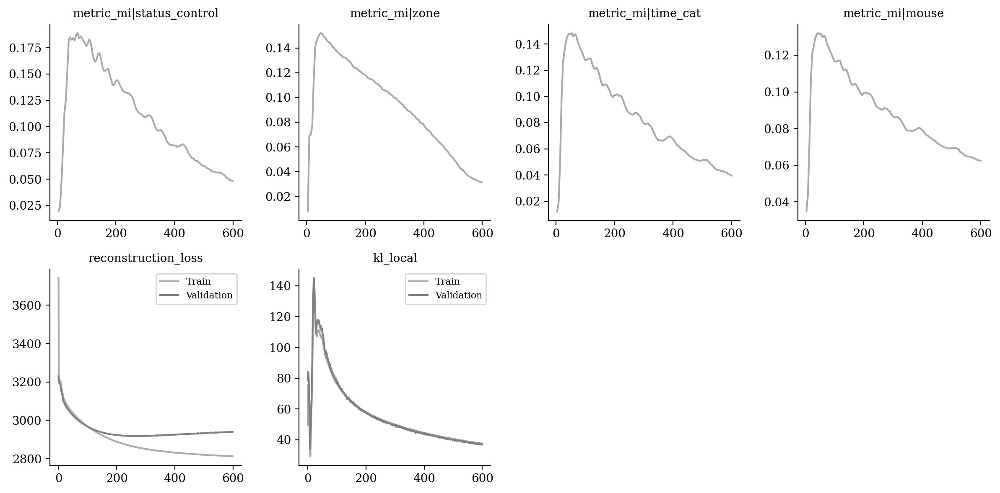

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

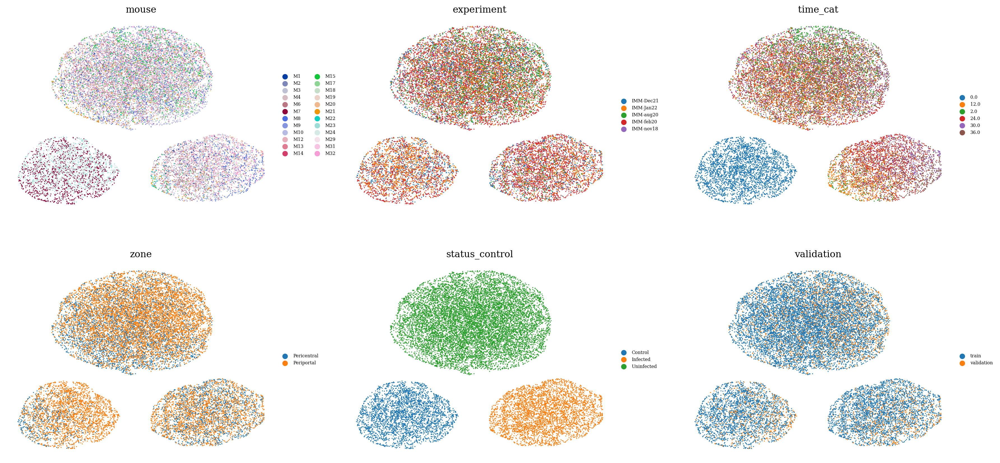

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

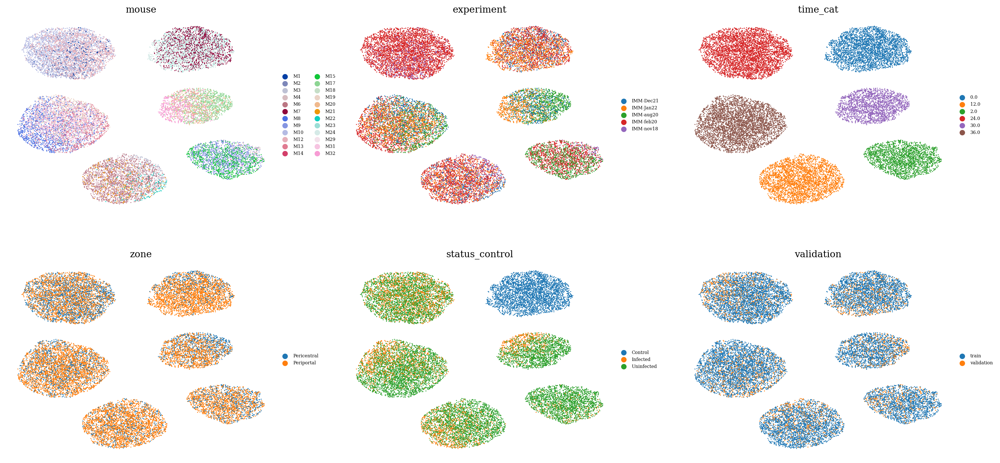

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

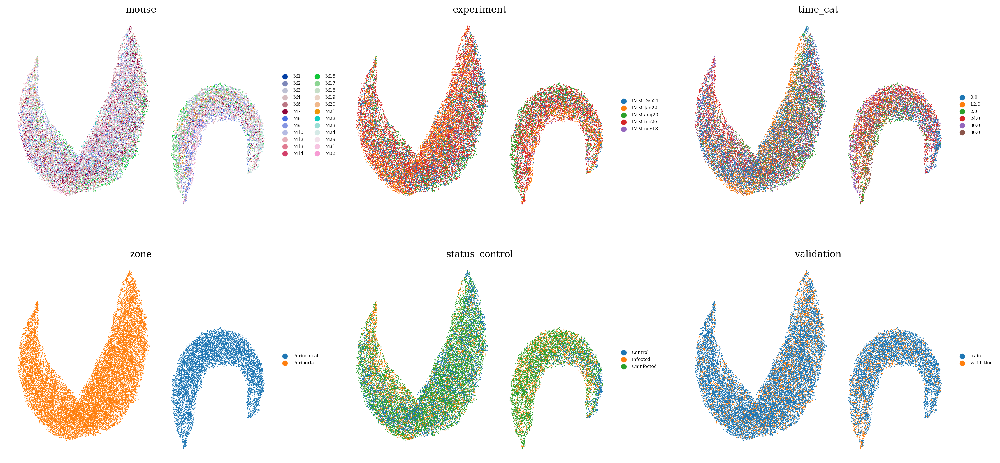

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

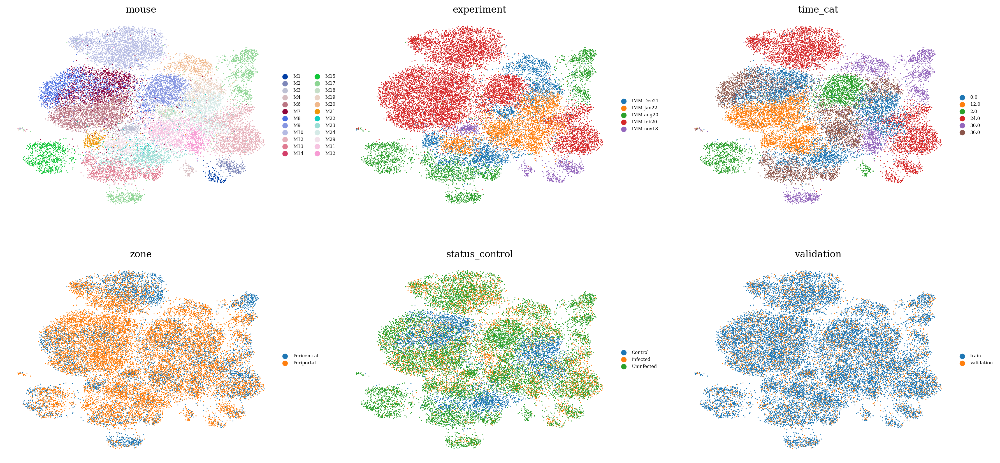

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

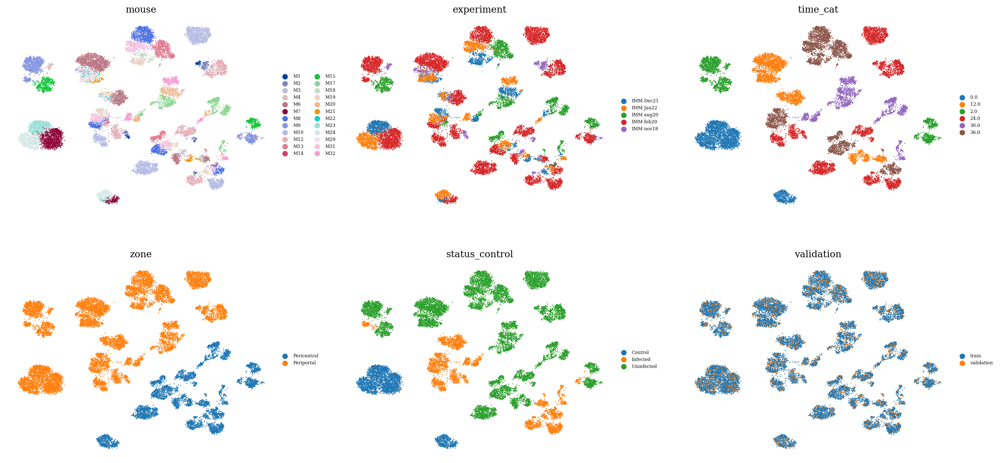

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

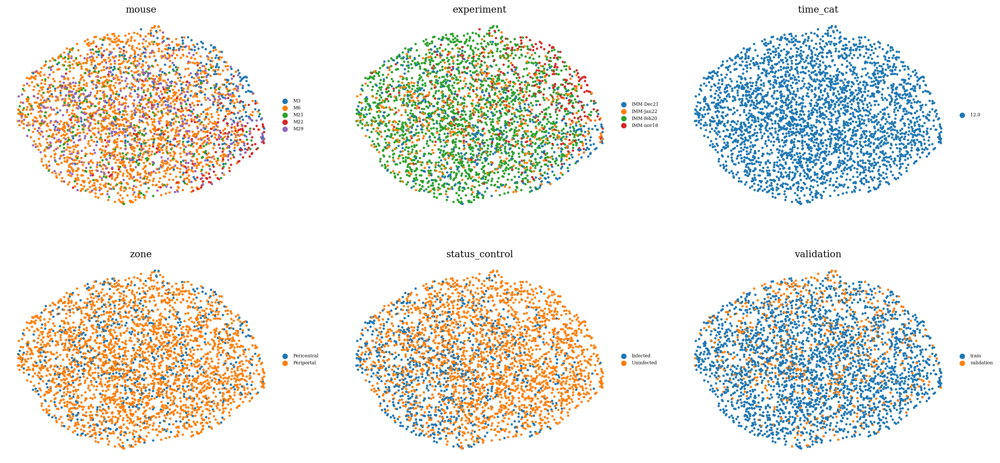

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )